# Accessing and analysing a REMO dataset

In [1]:
%load_ext autoreload
%autoreload 2

In this notebook we want to show some typical data analysis that might be useful to look at after or during a REMO run.

In [2]:
# import PyRemo as pr
# from matplotlib import pyplot as plt

# from tqdm.autonotebook import tqdm
import numpy as np
import xarray as xr

import pyremo as pr

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

/mnt/lustre01/pf/zmaw/g300046/python/packages/pyremo/pyremo/cmor/remo_cmor.py:16: UserWarning: no python cmor available
  warnings.warn("no python cmor available")


We will do the processing at DKRZ where we reserve a shared node for distributed computing with dask.

In [3]:
from dask.distributed import Client

client = Client()
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /user/g300046/advanced//proxy/8787/status,
Dashboard: /user/g300046/advanced//proxy/8787/status,Workers: 6
Total threads: 24,Total memory: 31.25 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:34364,Workers: 6
Dashboard: /user/g300046/advanced//proxy/8787/status,Total threads: 24
Started: Just now,Total memory: 31.25 GiB
Comm: tcp://127.0.0.1:34507,Total threads: 4
Dashboard: /user/g300046/advanced//proxy/33741/status,Memory: 5.21 GiB
Nanny: tcp://127.0.0.1:40342,


In [4]:
from pyremo.analysis import analysis
from pyremo.archive import archive

In [119]:
arch = archive.RemoArchive("/work/ch0636/g300046/remo_results_056000", force_parse=True)

100%|██████████| 396/396 [00:00<00:00, 2570.91it/s]


In [134]:
arch.first_tfile()

['/scratch/g/g300046/_archive_extract/e056000t1979010106.nc']

In [59]:
# xr.open_mfdataset(arch.monthly(time_range=("1979", "1990-01")), parallel=True)

In [82]:
pr.codes.get_dict("ps")

{'variable': 'PS',
 'description': 'Surface pressure',
 'units': 'Pa',
 'layer': 1.0,
 'time_cell_method': None,
 'cf_name': 'ps',
 'code': 134}

In [90]:
filename = arch._extract_code(
    code=134, time_range=("1979-01", "1979-12"), parallel=True
)

100%|██████████| 12/12 [00:00<00:00, 928.61it/s]


In [91]:
arch.catalog.df

,usr_nr,exp_nr,type,date,path,suffix,code
0,56,0,f,2002-10-01,/work/ch0636/g300046/remo_results_056000/2002/...,.tar,<NA>
1,56,0,e,2002-08-01,/work/ch0636/g300046/remo_results_056000/2002/...,.tar,<NA>
2,56,0,s,2002-08-01,/work/ch0636/g300046/remo_results_056000/2002/...,.nc,<NA>
3,56,0,f,2002-11-01,/work/ch0636/g300046/remo_results_056000/2002/...,.tar,<NA>
4,56,0,n,2002-03-01,/work/ch0636/g300046/remo_results_056000/2002/...,.tar,<NA>
...,...,...,...,...,...,...,...
7,56,0,e,1979-08-01,/scratch/g/g300046/_archive_extract/e056000e_c...,.nc,134
8,56,0,e,1979-09-01,/scratch/g/g300046/_archive_extract/e056000e_c...,.nc,134
9,56,0,e,1979-10-01,/scratch/g/g300046/_archive_extract/e056000e_c...,.nc,134
10,56,0,e,1979-11-01,/scratch/g/g300046/_archive_extract/e056000e_c...,.nc,134


In [269]:
exp = analysis.RemoExperiment("/work/ch0636/g300046/remo_results_056000")

100%|██████████| 398/398 [00:00<00:00, 2596.81it/s]


In [260]:
exp

['hyai', 'hybi', 'hyam', 'hybm', 'rotated_latitude_longitude', 'QDB', 'QDBL', 'QDBW', 'QDBI', 'PS', 'TS', 'TSL', 'TSW', 'TSI', 'WS', 'SN', 'APRL', 'APRC', 'APRS', 'PSRED', 'RUNOFF', 'DRAIN', 'ACLCOV', 'U10', 'V10', 'TEMP2', 'DEW2', 'TSURF', 'TD', 'WIND10', 'AZ0', 'AZ0L', 'AZ0W', 'AZ0I', 'ALB', 'ALBEDO', 'ALSOL', 'ALSOW', 'ALSOI', 'SRADS', 'TRADS', 'SRAD0', 'TRAD0', 'USTR', 'USTRL', 'USTRW', 'USTRI', 'VSTR', 'VSTRL', 'VSTRW', 'VSTRI', 'EVAP', 'EVAPL', 'EVAPW', 'EVAPI', 'TDCL', 'TCLFS', 'TCLF0', 'WL', 'VGRAT', 'VLT', 'T2MAX', 'T2MIN', 'SRAD0U', 'SRADSU', 'TRADSU', 'TSN', 'TD3', 'TD4', 'TD5', 'SEAICE', 'SICED', 'TSMAX', 'TSMIN', 'WIMAX', 'SNMEL', 'DSNAC', 'QVI', 'ALWCVI', 'BFLHS', 'BFLHSL', 'BFLHSW', 'BFLHSI', 'BFLQDS', 'BFLQDSL', 'BFLQDSW', 'BFLQDSI', 'TLAMBDA', 'DLAMBDA', 'PORVOL', 'WI3', 'WI4', 'WI5', 'WI', 'WICL', 'U10ER', 'V10ER', 'VBM10M', 'GHPBL', 'ETRANS', 'EBSOIL', 'ESNOW', 'ESKIN', 'QIVI', 'AOD', 'FLTMWAT', 'FLTMIX', 'FLTWBSED', 'FLTULSED', 'FLSHF', 'FLHSN', 'FLHICE', 'FLHMIX', 

In [276]:
cru = analysis.CRU_TS4

<xarray.Dataset>
Dimensions:  (lon: 720, lat: 360)
Coordinates:
  * lon      (lon) float32 -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float32 -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Data variables:
    topo     (lat, lon) float32 dask.array<chunksize=(360, 720), meta=np.ndarray>
Attributes:
    CDI:          Climate Data Interface version 1.9.7.1 (http://mpimet.mpg.d...
    Conventions:  CF-1.6
    history:      Fri Mar 12 11:39:25 2021: cdo ifthen tmp.nc orog.nc ls_orog...
    CDO:          Climate Data Operators version 1.9.7.1 (http://mpimet.mpg.d...

In [279]:
ds = cru.dataset()

KeyboardInterrupt: 

In [281]:
xr.open_dataset(
    "/mnt/lustre02/work/ch0636/eddy/pool/obs/cru/CRU/TS4.04/original/cru_ts4.04.1901.2019.tmp.dat.nc"
)

<xarray.Dataset>
Dimensions:  (lon: 720, lat: 360, time: 1428)
Coordinates:
  * lon      (lon) float32 -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float32 -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * time     (time) datetime64[ns] 1901-01-16 1901-02-15 ... 2019-12-16
Data variables:
    tmp      (time, lat, lon) float32 ...
    stn      (time, lat, lon) float64 ...
Attributes:
    Conventions:  CF-1.4
    title:        CRU TS4.04 Mean Temperature
    institution:  Data held at British Atmospheric Data Centre, RAL, UK.
    source:       Run ID = 2004151855. Data generated from:tmp.2004011744.dtb
    history:      Wed 15 Apr 2020 19:58:33 BST : User ianharris : Program mak...
    references:   Information on the data is available at http://badc.nerc.ac...
    comment:      Access to these data is available to any registered CEDA user.
    contact:      support@ceda.ac.uk

In [261]:
bla = exp.lsm

In [268]:
exp.dataset(56)

<xarray.Dataset>
Dimensions:  (rlon: 433, rlat: 433, time: 456)
Coordinates:
  * rlon     (rlon) float64 -28.93 -28.82 -28.71 -28.6 ... 18.37 18.49 18.6
  * rlat     (rlat) float64 -23.93 -23.82 -23.71 -23.6 ... 23.37 23.49 23.6
    lon      (rlat, rlon) float64 dask.array<chunksize=(433, 433), meta=np.ndarray>
    lat      (rlat, rlon) float64 dask.array<chunksize=(433, 433), meta=np.ndarray>
  * time     (time) datetime64[ns] 1979-01-15 1979-02-15 ... 2016-12-15
Data variables:
    TSI      (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
Attributes:
    CDI:                  Climate Data Interface version 1.9.6 (http://mpimet...
    Conventions:          CF-1.6
    history:              preprocessing with pyremo = 0.1.0
    institution:          European Centre for Medium-Range Weather Forecasts
    CDO:                  Climate Data Operators version 1.9.6 (http://mpimet...
    _NCProperties:        version=2,netcdf=4.7.4,hdf5=1.10.6
    forcing_file_format:  NetCDF
    remo_version:         2.0.0
    git_branch:           nc_meta
    git_hash:             c4ee7f4
    system:               Linux eddy3 2.6.32-754.33.1.el6.x86_64 #1 SMP Mon A...

In [181]:
temp = exp.monthly.TEMP2.where(exp.lsm > 0)

In [254]:
exp.dataset(variables=["tas"])

NameError: name 'monthly' is not defined

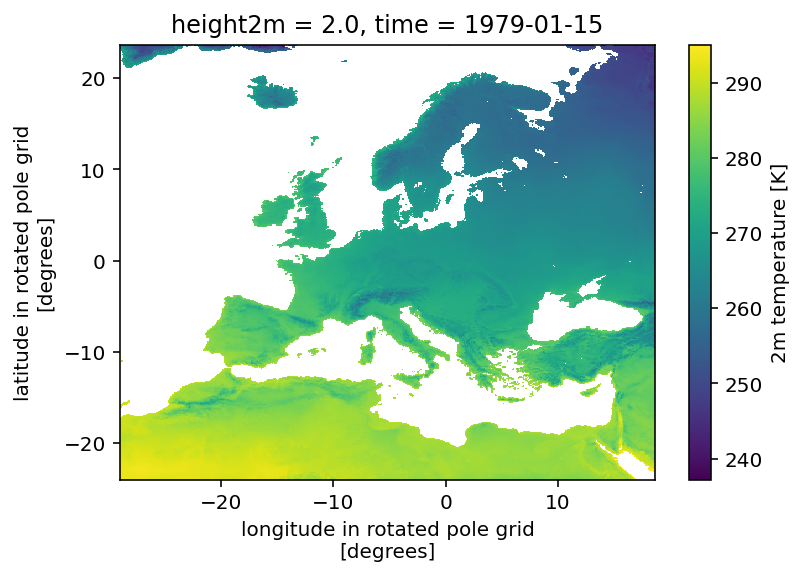

In [238]:
ds.TEMP2.isel(time=0).plot()

In [228]:
spin_up = exp.spin_up()

In [229]:
spin_up

,Array,Chunk
Bytes,24.94 kiB,8 B
Shape,"(7, 456, 1)","(1, 1, 1)"
Count,57457 Tasks,3192 Chunks
Type,float64,numpy.ndarray


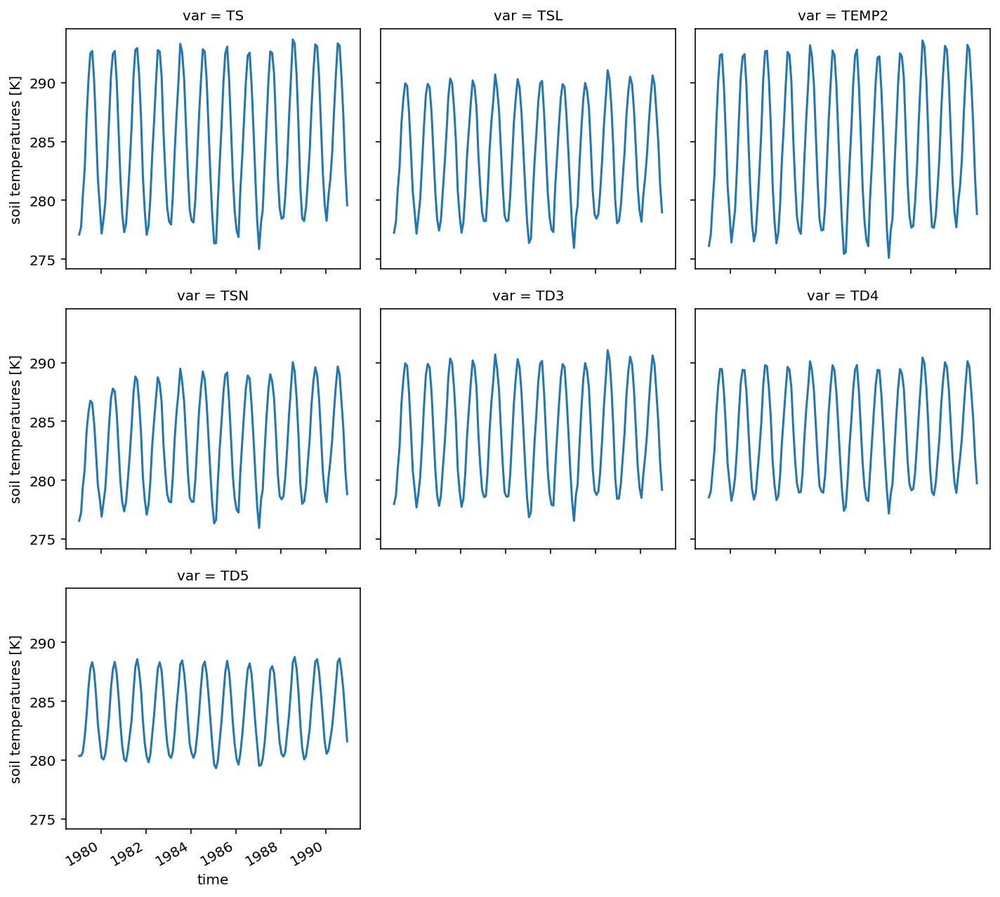

In [231]:
spin_up.sel(time=slice("1979", "1990")).plot(col="var", col_wrap=3)

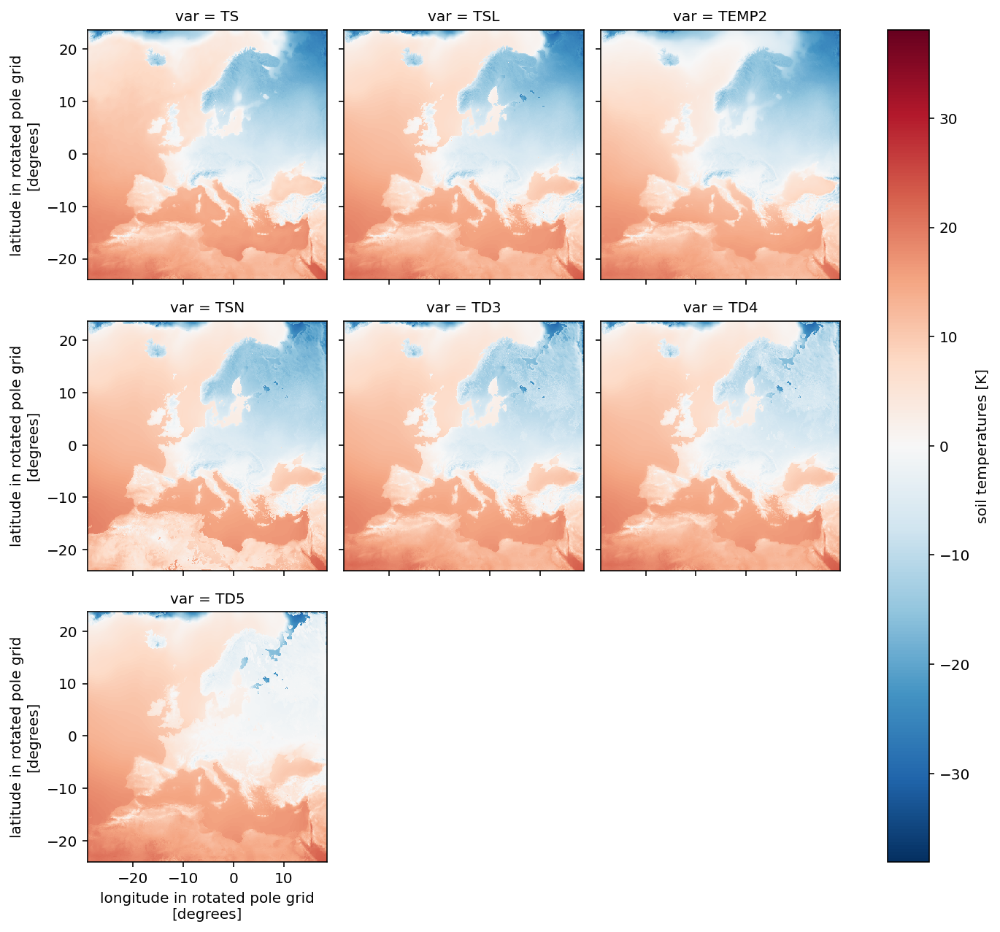

In [220]:
(soil - 273.5).isel(time=0).plot(col="var", col_wrap=3)

## Defining some helper functions

We will define a slightly different function for opening the monthly dataset that is based on some [xarray discussions on github](https://github.com/pydata/xarray/issues/1385#issuecomment-561920115).

In [52]:
def open_mfdataset(
    files,
    use_cftime=True,
    parallel=True,
    data_vars="minimal",
    chunks={"time": 1},
    coords="minimal",
    compat="override",
    drop=None,
    **kwargs,
):
    """optimized function for opening large cf datasets.

    based on https://github.com/pydata/xarray/issues/1385#issuecomment-561920115

    """

    def drop_all_coords(ds):
        # ds = ds.drop(drop)
        # ds = pr.preprocess(ds)
        return ds.reset_coords(drop=True)

    ds = xr.open_mfdataset(
        files,
        parallel=parallel,
        decode_times=False,
        combine="by_coords",
        preprocess=drop_all_coords,
        decode_cf=False,
        chunks=chunks,
        data_vars=data_vars,
        coords=coords,
        compat=compat,
        **kwargs,
    )
    return xr.decode_cf(ds, use_cftime=use_cftime)

Let's compute a weighted mean

In [16]:
def weighted_mean(values, grids, latitudes="rlat", longitudes="rlon"):
    """
    function to compute area-weighted spatial means
    """
    weight = np.cos(np.deg2rad(getattr(grids, latitudes)))
    return values.weighted(weight).mean(dim=(latitudes, longitudes))

First, let's define a function to conveniently plot all four seasons.

In [25]:
def plot_seasons(da, pole, vmin=None, vmax=None, cmap="coolwarm"):
    """plot seasonal means"""
    import cartopy.crs as ccrs
    from matplotlib import pyplot as plt

    transform = ccrs.RotatedPole(pole[0], pole[1])
    projection = transform
    # plt.subplots_adjust(hspace=1.5, wspace=1.0)
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(
        ncols=2, nrows=2, subplot_kw={"projection": projection}, figsize=(18, 14)
    )

    axes = (ax1, ax2, ax3, ax4)
    for ax in axes:
        # ax.set_axis_off()
        # ax.set_extent([da.rlon.min(), da.rlon.max(), da.rlat.min(), da.rlat.max()], crs=transform)
        ax.gridlines(
            draw_labels=True,
            linewidth=0.5,
            color="gray",
            xlocs=range(-180, 180, 10),
            ylocs=range(-90, 90, 10),
        )
        ax.coastlines(resolution="110m", color="black", linewidth=1)
    for season, ax in zip(da.season, axes):
        im = da.sel(season=season).plot(
            ax=ax,
            vmin=vmin,
            vmax=vmax,
            cmap=cmap,
            transform=transform,
            add_colorbar=False,
        )
    cbar = fig.colorbar(im, ax=axes)
    return plt

Now, we compute seasonal means with a simple groupy approach.

In [36]:
def seasonal_means(da):
    """
    Function to compute seasonal means with a simple groupby approach
    """

    return da.groupby("time.season").mean(dim="time")

We will regrid the data to a coarser grid to avoid creating *artificial* observations.

In [43]:
def get_regridder(coarser, finer, mode="bilinear"):
    """
    Function to regrid data bilinearly to a coarser grid
    """

    return xe.Regridder(finer, coarser, mode)

## Access and preparation of REMO output

For this notebook, we use 10 years of preliminary test results from a REMO run using ERA5 data as lateral boundary forcings. We will only use monthly mean data for this analysis, so let's catch that data from the filesystem:

In [ ]:
import glob

pattern = "/work/ch0636/g300046/remo_results_056000/19[78]*/e056000m*.nc"
filenames = glob.glob(pattern)
filenames.sort()
filenames

In [51]:
%time ds = open_mfdataset(exp.filenames['mon'], chunks='auto')

NameError: name 'open_mfdataset' is not defined

In [7]:
ds = pr.preprocess(ds)

In [8]:
ds

<xarray.Dataset>
Dimensions:                     (rlon: 433, rlat: 433, meansea: 1, height10m: 1, height2m: 1, lev_4: 1, nhyi: 28, nhym: 27, lev_5: 1, snlevs: 3, time: 132)
Coordinates:
  * rlon                        (rlon) float64 -28.93 -28.82 ... 18.49 18.6
  * rlat                        (rlat) float64 -23.93 -23.82 ... 23.49 23.6
  * meansea                     (meansea) float64 0.0
  * height10m                   (height10m) float64 10.0
  * height2m                    (height2m) float64 2.0
  * lev_4                       (lev_4) float64 1.0
  * lev_5                       (lev_5) float64 27.0
  * snlevs                      (snlevs) float64 1.0 2.0 3.0
    lon                         (rlat, rlon) float64 dask.array<chunksize=(433, 433), meta=np.ndarray>
    lat                         (rlat, rlon) float64 dask.array<chunksize=(433, 433), meta=np.ndarray>
  * time                        (time) datetime64[ns] 1979-01-15 ... 1989-12-15
Dimensions without coordinates: nhyi, nhym
Data variables: (12/129)
    hyai                        (nhyi) float64 dask.array<chunksize=(28,), meta=np.ndarray>
    hybi                        (nhyi) float64 dask.array<chunksize=(28,), meta=np.ndarray>
    hyam                        (nhym) float64 dask.array<chunksize=(27,), meta=np.ndarray>
    hybm                        (nhym) float64 dask.array<chunksize=(27,), meta=np.ndarray>
    rotated_latitude_longitude  |S1 ...
    QDB                         (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
    ...                          ...
    ALSOFL                      (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
    USTRFL                      (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
    VSTRFL                      (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
    EVAPFL                      (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
    TMCHFL                      (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
    SNMLRHO                     (time, snlevs, rlat, rlon) float32 dask.array<chunksize=(1, 3, 433, 433), meta=np.ndarray>
Attributes:
    CDI:                  Climate Data Interface version 1.9.6 (http://mpimet...
    Conventions:          CF-1.6
    history:              preprocessing with pyremo = 0.1.0
    institution:          European Centre for Medium-Range Weather Forecasts
    CDO:                  Climate Data Operators version 1.9.6 (http://mpimet...
    _NCProperties:        version=2,netcdf=4.7.4,hdf5=1.10.6
    forcing_file_format:  NetCDF
    remo_version:         2.0.0
    git_branch:           nc_meta
    git_hash:             c4ee7f4
    system:               Linux eddy3 2.6.32-754.33.1.el6.x86_64 #1 SMP Mon A...

In [9]:
from pyremo.analysis import analysis

In [12]:
analysis.soil.extract(ds)  # .TS.isel(time=0).plot()

<xarray.Dataset>
Dimensions:   (rlon: 433, rlat: 433, time: 132, height2m: 1)
Coordinates:
  * rlon      (rlon) float64 -28.93 -28.82 -28.71 -28.6 ... 18.37 18.49 18.6
  * rlat      (rlat) float64 -23.93 -23.82 -23.71 -23.6 ... 23.37 23.49 23.6
    lon       (rlat, rlon) float64 dask.array<chunksize=(433, 433), meta=np.ndarray>
    lat       (rlat, rlon) float64 dask.array<chunksize=(433, 433), meta=np.ndarray>
  * time      (time) datetime64[ns] 1979-01-15 1979-02-15 ... 1989-12-15
  * height2m  (height2m) float64 2.0
Data variables:
    TS        (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
    TSL       (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
    TEMP2     (time, height2m, rlat, rlon) float32 dask.array<chunksize=(1, 1, 433, 433), meta=np.ndarray>
    TSN       (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
    TD3       (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
    TD4       (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
    TD5       (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
Attributes:
    CDI:                  Climate Data Interface version 1.9.6 (http://mpimet...
    Conventions:          CF-1.6
    history:              preprocessing with pyremo = 0.1.0
    institution:          European Centre for Medium-Range Weather Forecasts
    CDO:                  Climate Data Operators version 1.9.6 (http://mpimet...
    _NCProperties:        version=2,netcdf=4.7.4,hdf5=1.10.6
    forcing_file_format:  NetCDF
    remo_version:         2.0.0
    git_branch:           nc_meta
    git_hash:             c4ee7f4
    system:               Linux eddy3 2.6.32-754.33.1.el6.x86_64 #1 SMP Mon A...

In [11]:
soil_temps = analysis.get_soil_temps(ds)

AttributeError: module 'pyremo.analysis.analysis' has no attribute 'get_soil_temps'

In [11]:
soil_temps

<xarray.DataArray 'soil_temperatures' (var: 7, time: 132, rlat: 433, rlon: 433, height2m: 1)>
dask.array<concatenate, shape=(7, 132, 433, 433, 1), dtype=float32, chunksize=(1, 1, 433, 433, 1), chunktype=numpy.ndarray>
Coordinates:
  * height2m  (height2m) float64 2.0
  * rlon      (rlon) float64 -28.93 -28.82 -28.71 -28.6 ... 18.37 18.49 18.6
  * rlat      (rlat) float64 -23.93 -23.82 -23.71 -23.6 ... 23.37 23.49 23.6
    lon       (rlat, rlon) float64 dask.array<chunksize=(433, 433), meta=np.ndarray>
    lat       (rlat, rlon) float64 dask.array<chunksize=(433, 433), meta=np.ndarray>
  * time      (time) datetime64[ns] 1979-01-15 1979-02-15 ... 1989-12-15
  * var       (var) <U5 'TS' 'TSL' 'TEMP2' 'TSN' 'TD3' 'TD4' 'TD5'
Attributes:
    long_name:     soil temperatures
    units:         K
    code:          139
    leveltype:     1
    grid_mapping:  rotated_latitude_longitude
    variable:      TS
    description:   surface temperature (mean over gridbox)
    layer:         1.0

[autoreload of pyremo.analysis.analysis failed: Traceback (most recent call last):
  File "/work/ch0636/g300046/conda_envs/cmip6-processing/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/work/ch0636/g300046/conda_envs/cmip6-processing/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 394, in superreload
    module = reload(module)
  File "/work/ch0636/g300046/conda_envs/cmip6-processing/lib/python3.9/imp.py", line 314, in reload
    return importlib.reload(module)
  File "/work/ch0636/g300046/conda_envs/cmip6-processing/lib/python3.9/importlib/__init__.py", line 169, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 613, in _exec
  File "<frozen importlib._bootstrap_external>", line 790, in exec_module
  File "<frozen importlib._bootstrap>", line 228, in _call_with_frames_removed
  File "/mnt/lustre01/pf/zmaw/g300046/python/packages/pyremo/p

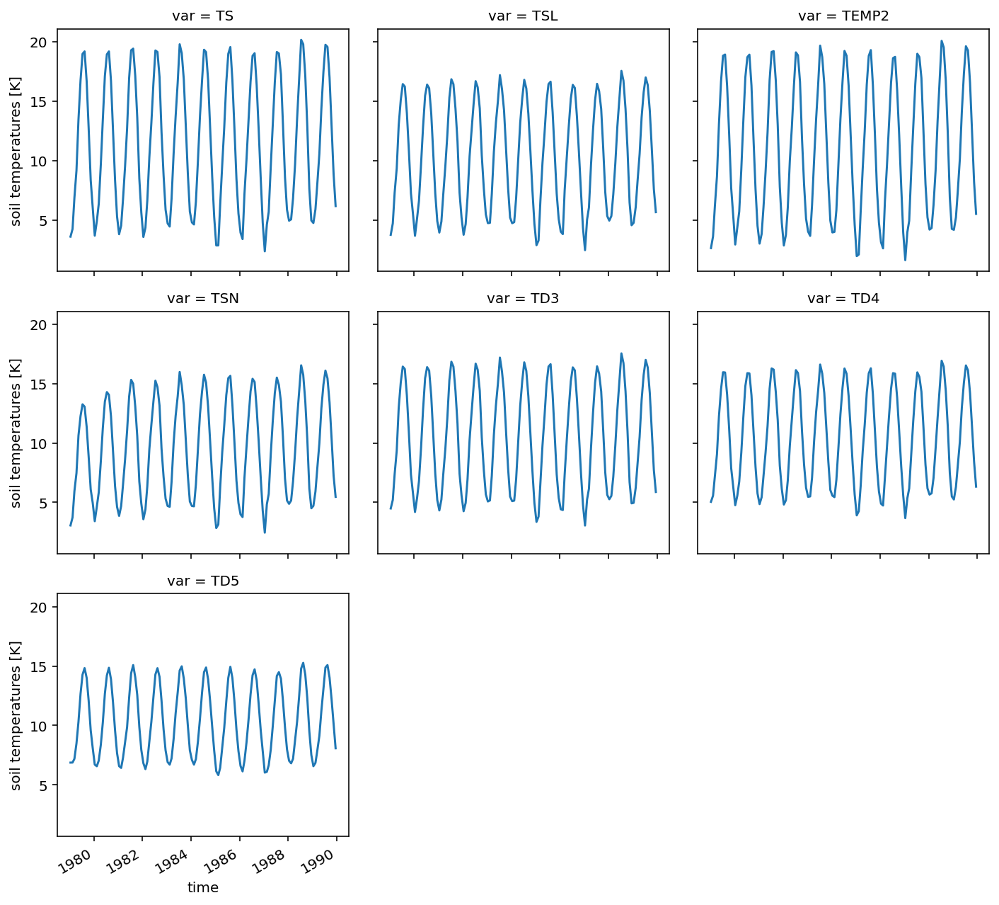

In [17]:
analysis.weighted_field_mean(soil_temps).plot(col="var", col_wrap=3)

We now have our 10 years of monthly REMO output in one dataset. Please remember, that [xarray uses dask under the hood](http://xarray.pydata.org/en/stable/user-guide/dask.html) (if you have installed it!) which means that we can easily work and analyze large datasets that would normally not fit into our memory (or because we simply don't want all data loaded and slow us down).

For historical reason, the current REMO version sets the day of the month to 0 for monthly means. This is not compatible, e.g., with standard datetime formats. We provided a function to correct the time axis here.

In [7]:
from datetime import datetime as dt

time = list(ds.time.astype(str).values)
ds["time"] = [dt.strptime(t[0:6], "%Y%m") for t in time]

Now, we have a reasonable time axis in the dataset that makes analysis much easier:

In [8]:
ds.time[:5]

<xarray.DataArray 'time' (time: 5)>
array(['1979-01-01T00:00:00.000000000', '1979-02-01T00:00:00.000000000',
       '1979-03-01T00:00:00.000000000', '1979-04-01T00:00:00.000000000',
       '1979-05-01T00:00:00.000000000'], dtype='datetime64[ns]')
Coordinates:
  * time     (time) datetime64[ns] 1979-01-01 1979-02-01 ... 1979-05-01

Now, let's have a look at the dataset:

In [9]:
ds

<xarray.Dataset>
Dimensions:                     (height10m: 1, height2m: 1, lev_4: 1, lev_5: 1, meansea: 1, nhyi: 28, nhym: 27, rlat: 433, rlon: 433, snlevs: 3, time: 132)
Coordinates:
  * rlon                        (rlon) float64 -28.93 -28.82 ... 18.49 18.6
  * rlat                        (rlat) float64 -23.93 -23.82 ... 23.49 23.6
  * meansea                     (meansea) float64 0.0
  * height10m                   (height10m) float64 10.0
  * height2m                    (height2m) float64 2.0
  * lev_4                       (lev_4) float64 1.0
  * lev_5                       (lev_5) float64 27.0
  * snlevs                      (snlevs) float64 1.0 2.0 3.0
    lon                         (rlat, rlon) float64 dask.array<chunksize=(433, 433), meta=np.ndarray>
    lat                         (rlat, rlon) float64 dask.array<chunksize=(433, 433), meta=np.ndarray>
  * time                        (time) datetime64[ns] 1979-01-01 ... 1989-12-01
Dimensions without coordinates: nhyi, nhym
Data variables: (12/129)
    hyai                        (nhyi) float64 dask.array<chunksize=(28,), meta=np.ndarray>
    hybi                        (nhyi) float64 dask.array<chunksize=(28,), meta=np.ndarray>
    hyam                        (nhym) float64 dask.array<chunksize=(27,), meta=np.ndarray>
    hybm                        (nhym) float64 dask.array<chunksize=(27,), meta=np.ndarray>
    rotated_latitude_longitude  |S1 ...
    QDB                         (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
    ...                          ...
    ALSOFL                      (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
    USTRFL                      (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
    VSTRFL                      (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
    EVAPFL                      (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
    TMCHFL                      (time, rlat, rlon) float32 dask.array<chunksize=(1, 433, 433), meta=np.ndarray>
    SNMLRHO                     (time, snlevs, rlat, rlon) float32 dask.array<chunksize=(1, 3, 433, 433), meta=np.ndarray>
Attributes:
    CDI:                  Climate Data Interface version 1.9.6 (http://mpimet...
    Conventions:          CF-1.6
    history:              Mon Mar 08 09:08:20 2021: cdo -t remo -f nc copy a0...
    source:               REMO
    institution:          Max-Planck-Institute for Meteorology
    CDO:                  Climate Data Operators version 1.9.6 (http://mpimet...
    forcing_file_format:  NetCDF
    remo_version:         2.0.0
    system:               Linux eddy3 2.6.32-754.33.1.el6.x86_64 #1 SMP Mon A...

Now, get the first and the last simulated years

In [10]:
startyear = time[0][:4]
stopyear = time[-1][:4]
startyear, stopyear

('1979', '1989')

You can see that we got 129 data variables and a lot of coordinates. We will focus on some common variables for analysis. However, first, let's look at the size of the dataset.

In [11]:
ds.nbytes / 1.0e9  # in GB

12.476276945

Not too bad, 12 GB would fit into the memory, e.g. at DKRZ, but probably would be too large for a laptop. It's good that we load that dataset lazily and will only load data if we need it.

It's also handy to grep the pole information about the grid mapping from the dataset for plotting:

In [12]:
pole = (
    ds.rotated_latitude_longitude.grid_north_pole_longitude,
    ds.rotated_latitude_longitude.grid_north_pole_latitude,
)
pole

(-162.0, 39.25)

## Spin up

It's always useful to look at the soil temperatures. During the run, the soil has to get into an equilibrium with the atmospheric temperature to *forget* the initial conditions.

In [12]:
# def vars_by_units(ds, units):
#    temps = [var for var in ds if ds[var].attrs.get('units', None) == units]
#    dim=xr.DataArray(data=temps, dims='var', name='var')
#    return xr.concat([ds[var]-273.5 for var in temps], dim=dim)

Let's look at the following variables:

In [13]:
temp_vars = ["TS", "TSL", "TEMP2", "TSN", "TD3", "TD4", "TD5"]

We will extract those variables from the big dataset and stuff them into a coordinate so that we can easily plot them.

In [14]:
dim = xr.DataArray(data=temp_vars, dims="var", name="var")
temps = xr.concat([ds[var] - 273.5 for var in temp_vars], dim=dim)
temps.name = "temperatures"
temps

<xarray.DataArray 'temperatures' (var: 7, time: 132, rlat: 433, rlon: 433, height2m: 1)>
dask.array<concatenate, shape=(7, 132, 433, 433, 1), dtype=float32, chunksize=(1, 1, 433, 433, 1), chunktype=numpy.ndarray>
Coordinates:
  * height2m  (height2m) float64 2.0
  * rlon      (rlon) float64 -28.93 -28.82 -28.71 -28.6 ... 18.37 18.49 18.6
  * rlat      (rlat) float64 -23.93 -23.82 -23.71 -23.6 ... 23.37 23.49 23.6
    lon       (rlat, rlon) float64 dask.array<chunksize=(433, 433), meta=np.ndarray>
    lat       (rlat, rlon) float64 dask.array<chunksize=(433, 433), meta=np.ndarray>
  * time      (time) datetime64[ns] 1979-01-01 1979-02-01 ... 1989-12-01
  * var       (var) <U5 'TS' 'TSL' 'TEMP2' 'TSN' 'TD3' 'TD4' 'TD5'

Great, now lets' compute the spatial means (or field mean) for the 10 years...

In [18]:
temps_mean = weighted_mean(temps, ds)
temps_mean

,Array,Chunk
Bytes,7.22 kiB,8 B
Shape,"(7, 132, 1)","(1, 1, 1)"
Count,17557 Tasks,924 Chunks
Type,float64,numpy.ndarray


You can see that the data is still nicely chunked. We have not triggered any computation yet because we didn't actually look at the data yet. But now, we want to plot the data. To show the computation here, we will explicitly trigger it! Usually, you could just go on with plotting and the computation is done automatically.

In [19]:

%time temps_mean_ = temps_mean.persist()  # start computation
%time progress(temps_mean_)

CPU times: user 920 ms, sys: 9 ms, total: 929 ms
Wall time: 964 ms
CPU times: user 5 ms, sys: 0 ns, total: 5 ms
Wall time: 4.85 ms


VBox()

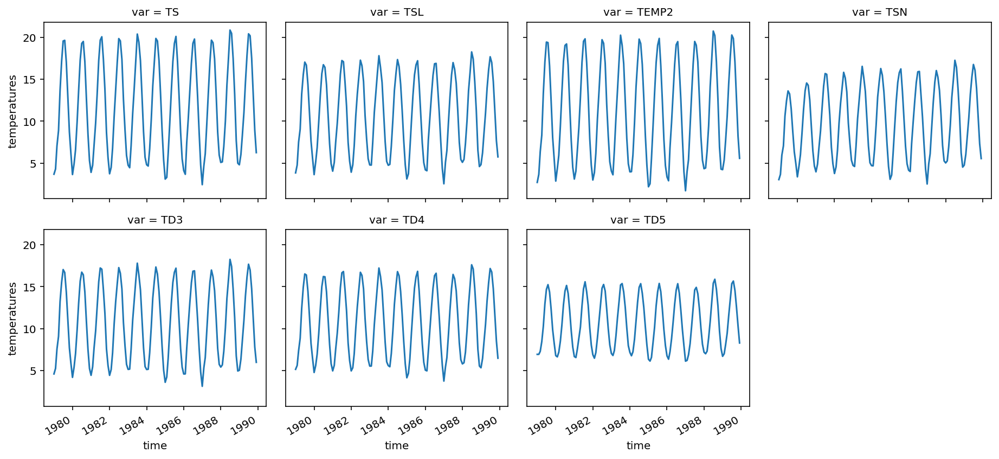

In [39]:
temps_mean_.plot(col="var", col_wrap=4)

We can see that the soil temperatures seem to be fine and in equilibrium with the atmosphere!

## Seasonal means

Now, we compute seasonal means.

In [37]:
temp2_seasmean_ = seasonal_means(ds.TEMP2)

We can have a look using our nice plotting function.

<module 'matplotlib.pyplot' from '/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/matplotlib/pyplot.py'>

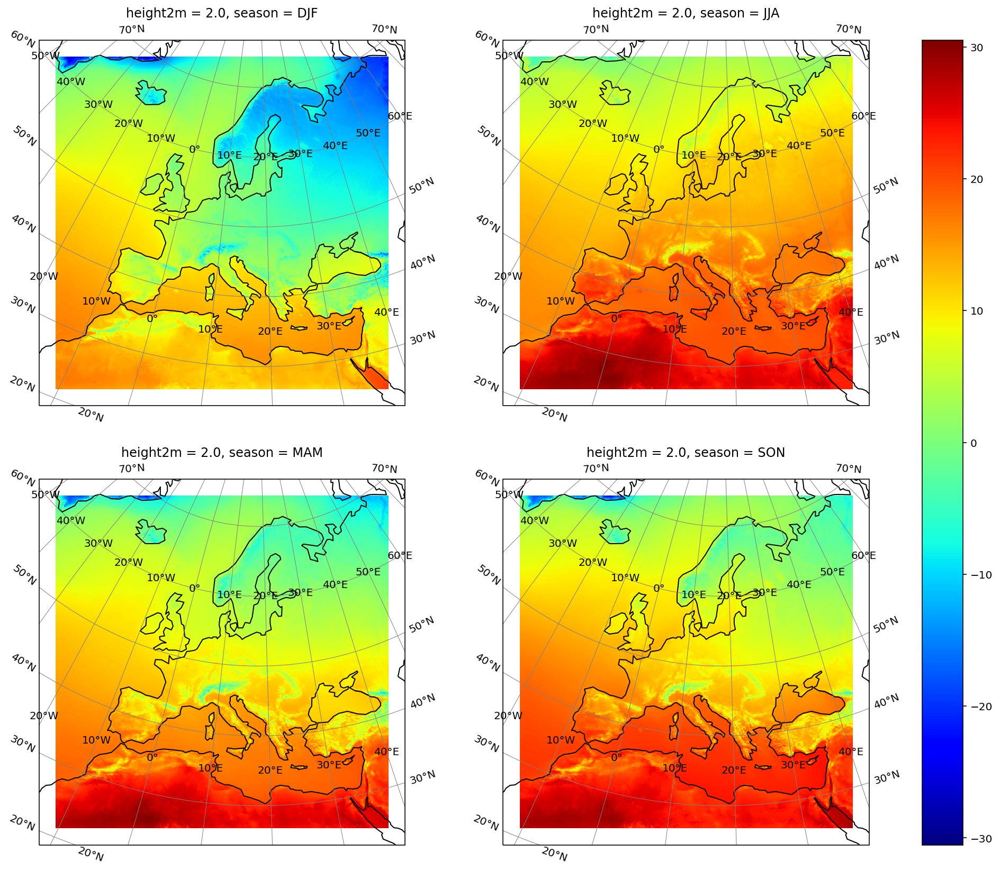

In [38]:
plot_seasons(temp2_seasmean_ - 273.5, pole, cmap="jet")

### Annual cycle

In [24]:
values = temps.groupby("time.month").mean("time")
temps_cycle = weighted_mean(values, ds)
temps_cycle

<xarray.DataArray 'temperatures' (var: 7, month: 12, height2m: 1)>
dask.array<truediv, shape=(7, 12, 1), dtype=float64, chunksize=(1, 1, 1), chunktype=numpy.ndarray>
Coordinates:
  * height2m  (height2m) float64 2.0
  * var       (var) <U5 'TS' 'TSL' 'TEMP2' 'TSN' 'TD3' 'TD4' 'TD5'
  * month     (month) int64 1 2 3 4 5 6 7 8 9 10 11 12

In [105]:

%time temps_cycle_ = temps_cycle.persist()  # start computation
%time progress(temps_cycle_)

CPU times: user 358 ms, sys: 8 ms, total: 366 ms
Wall time: 360 ms
CPU times: user 4 ms, sys: 0 ns, total: 4 ms
Wall time: 4.02 ms


VBox()

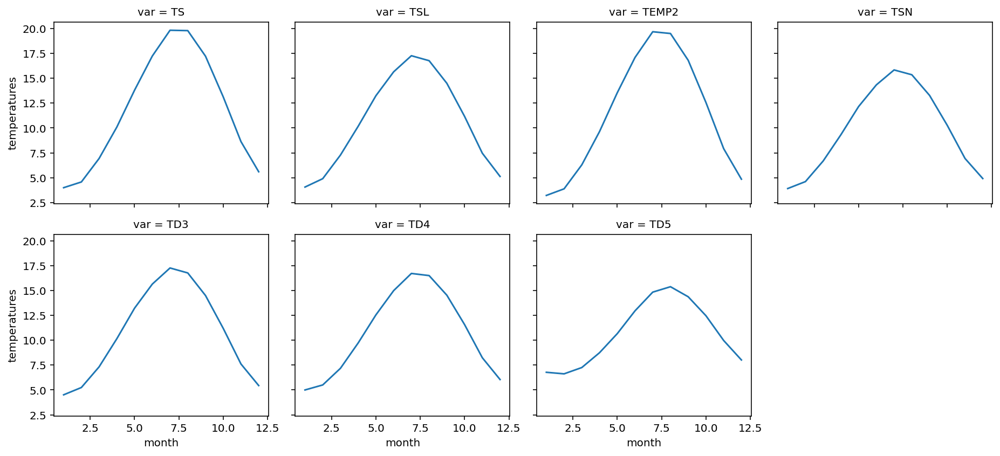

In [106]:
temps_cycle_.plot(col="var", col_wrap=4)

## Comparison with observations

This is the exciting part. Let's compare our model results with gridded observational data! We will start with [CRU TS4](https://catalogue.ceda.ac.uk/uuid/89e1e34ec3554dc98594a5732622bce9).

In [116]:
cru = analysis.CRU_TS4

In [117]:
cru.orog

'/mnt/lustre02/work/ch0636/eddy/pool/obs/cru/CRU/TS4.04/original/cru404_c129.nc'

### CRU TS4

In [40]:
cru_ts = "/mnt/lustre02/work/ch0636/eddy/pool/obs/cru/CRU/TS4.04/original/cru_ts4.04.1901.2019.tmp.dat.nc"
# %time cru_tmp = xr.open_dataset(cru_ts.format(var='tmp'), chunks='auto', use_cftime=True)
cru_tmp = open_mfdataset(cru_ts)

In [41]:
cru_tmp

<xarray.Dataset>
Dimensions:  (lat: 360, lon: 720, time: 1428)
Coordinates:
  * lon      (lon) float32 -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float32 -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * time     (time) object 1901-01-16 00:00:00 ... 2019-12-16 00:00:00
Data variables:
    tmp      (time, lat, lon) float32 dask.array<chunksize=(1, 360, 720), meta=np.ndarray>
    stn      (time, lat, lon) float64 dask.array<chunksize=(1, 360, 720), meta=np.ndarray>
Attributes:
    Conventions:  CF-1.4
    title:        CRU TS4.04 Mean Temperature
    institution:  Data held at British Atmospheric Data Centre, RAL, UK.
    source:       Run ID = 2004151855. Data generated from:tmp.2004011744.dtb
    history:      Wed 15 Apr 2020 19:58:33 BST : User ianharris : Program mak...
    references:   Information on the data is available at http://badc.nerc.ac...
    comment:      Access to these data is available to any registered CEDA user.
    contact:      support@ceda.ac.uk

The CRU data has a resolutio of roughly 50 km. To compare out REMO output with the CRU data, we will regrid the model data to the coarser CRU grid to avoid creating *artificial* observations.

In [44]:
%time regridder = get_regridder(ds, cru_tmp)
regridder

CPU times: user 5.99 s, sys: 369 ms, total: 6.36 s
Wall time: 9.16 s


xESMF Regridder 
Regridding algorithm:       bilinear 
Weight filename:            bilinear_360x720_433x433.nc 
Reuse pre-computed weights? False 
Input grid shape:           (360, 720) 
Output grid shape:          (433, 433) 
Periodic in longitude?      False

The CRU data is defined over land only. Let's get the REMO land-sea-mask from a t-file.

In [ ]:
import os
import tarfile

tar = tarfile.open("/work/ch0636/g300046/remo_results_056000/1979/e056000t197901.tar")
scratch = os.environ.get("SCRATCH")
path = os.path.join(scratch, "remo-tmp")
remo_lsm = open_mfdataset(tar.extractfile("e056000t1979010106.nc")).BLA.isel(
    time=0, drop=True
)

We want a mask that only shows our EUR-11 region on the CRU grid.

/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/xesmf/frontend.py:466: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  dr_out = xr.apply_ufunc(


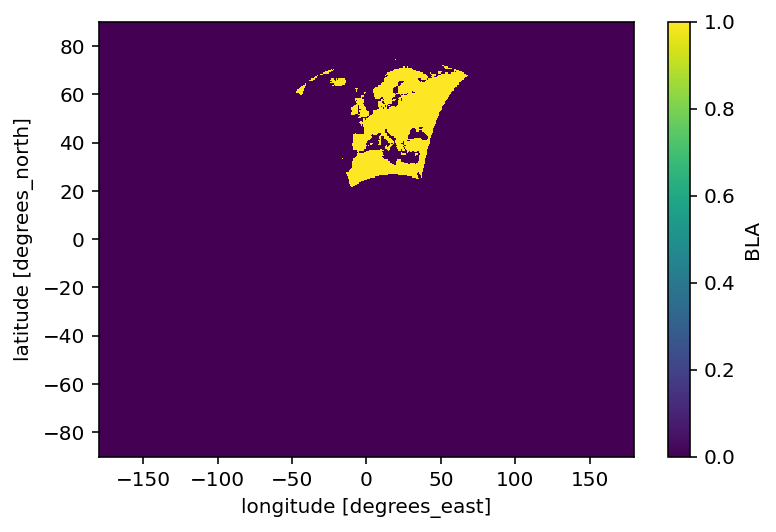

In [24]:
mask = xr.where(cru_tmp.tmp[0].isnull(), False, True)
mask = xr.where(regridder(remo_lsm) > 0, True, False).squeeze(drop=True)
mask.plot()

Compute seasonal means and difference between REMO and CRU. First, calculate REMO seasmean and then regrid to the coarser CRU grid

In [25]:
cru_seasmean = (
    cru_tmp.tmp.sel(time=slice(startyear, stopyear)).groupby("time.season").mean("time")
)
remo_seasmean = ds.TEMP2.groupby("time.season").mean("time") - 273.5
remo_seasmean = regridder(remo_seasmean)
remo_seasmean = remo_seasmean.where(remo_seasmean != 0.0)
diff1 = remo_seasmean - cru_seasmean

/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/xesmf/frontend.py:466: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  dr_out = xr.apply_ufunc(


We need to define a new plotting function because we now plot on the CRU grid.

In [26]:
def plot_seasons(da, pole, vmin=None, vmax=None, cmap="bwr"):
    """plot seasonal means"""
    import cartopy.crs as ccrs
    from matplotlib import pyplot as plt

    transform = ccrs.RotatedPole(pole[0], pole[1])
    projection = transform
    # plt.subplots_adjust(hspace=1.5, wspace=1.0)
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(
        ncols=2, nrows=2, subplot_kw={"projection": projection}, figsize=(18, 14)
    )

    axes = (ax1, ax2, ax3, ax4)
    for ax in axes:
        # ax.set_axis_off()
        ax.set_extent(
            [ds.rlon.min(), ds.rlon.max(), ds.rlat.min(), ds.rlat.max()], crs=transform
        )
        ax.gridlines(
            draw_labels=True,
            linewidth=0.5,
            color="gray",
            xlocs=range(-180, 180, 10),
            ylocs=range(-90, 90, 10),
        )
        ax.coastlines(resolution="50m", color="black", linewidth=1)
    for season, ax in zip(da.season, axes):
        im = da.sel(season=season).plot(
            ax=ax,
            vmin=vmin,
            vmax=vmax,
            cmap=cmap,
            transform=ccrs.PlateCarree(),
            add_colorbar=False,
        )
    cbar = fig.colorbar(im, ax=axes)
    return plt

Use the regridded REMO land-sea-mask for masking.

<module 'matplotlib.pyplot' from '/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/matplotlib/pyplot.py'>

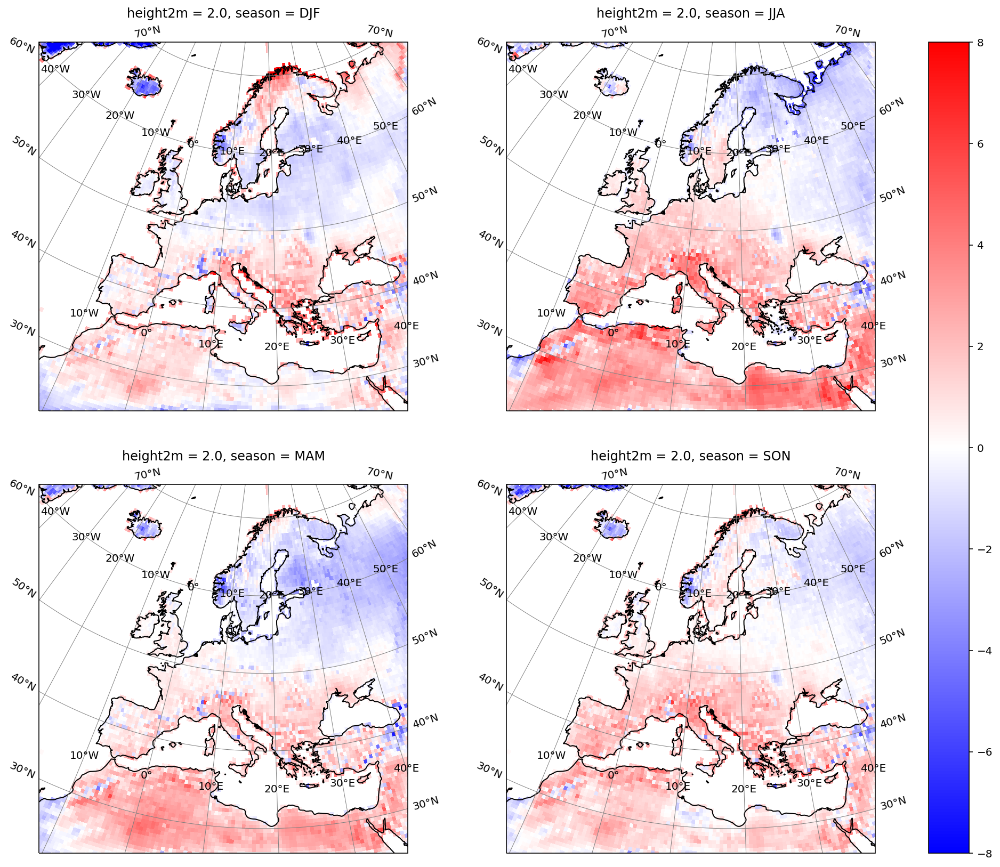

In [27]:
plot_seasons(diff1.where(mask > 0, drop=True), pole, vmin=-8, vmax=8)

This seems to be ok. We used the REMO land sea mask before regridding to get rid of most of the remappping artifacts.

#### Height correction

We will add a height correction based on the different topographies. Let's define a function for this:

In [28]:
def height_correction(height1, height2):
    """returns height correction in m"""
    return (height1 - height2) * 0.0065

I found this topography file for CRU:

In [29]:
cru_topo = xr.open_dataset(
    "/mnt/lustre02/work/ch0636/eddy/pool/obs/cru/CRU/TS4.04/original/cru404_c129.nc"
).topo
cru_topo

<xarray.DataArray 'topo' (lat: 360, lon: 720)>
[259200 values with dtype=float32]
Coordinates:
  * lon      (lon) float32 -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8
  * lat      (lat) float32 -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
Attributes:
    units:    m

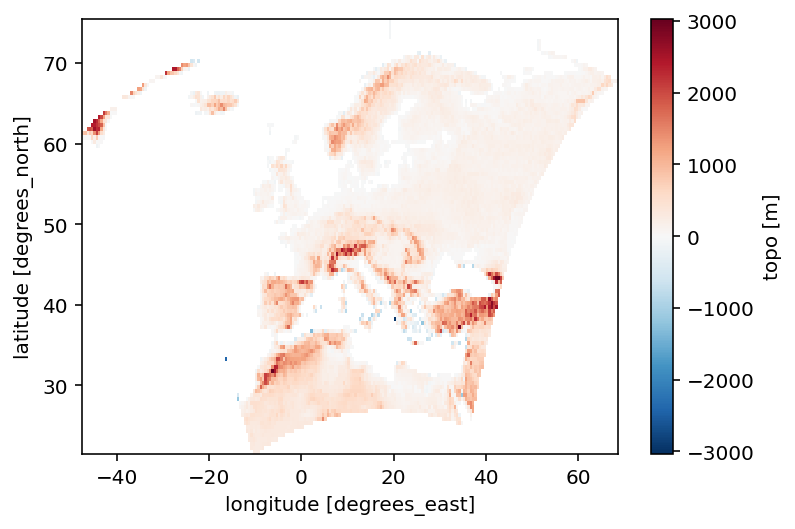

In [30]:
cru_topo.where(mask > 0, drop=True).plot()

We grab the REMO topography from a t-file

In [31]:
import os
import tarfile

tar = tarfile.open("/work/ch0636/g300046/remo_results_056000/1979/e056000t197901.tar")
scratch = os.environ.get("SCRATCH")
path = os.path.join(scratch, "remo-tmp")
remo_topo = xr.open_dataset(tar.extractfile("e056000t1979010106.nc")).FIB.isel(
    time=0, drop=True
)

In [40]:
remo_topo

<xarray.DataArray 'FIB' (rlat: 433, rlon: 433)>
[187489 values with dtype=float32]
Coordinates:
  * rlon     (rlon) float64 -28.93 -28.82 -28.71 -28.6 ... 18.37 18.49 18.6
  * rlat     (rlat) float64 -23.93 -23.82 -23.71 -23.6 ... 23.37 23.49 23.6
    lon      (rlat, rlon) float64 ...
    lat      (rlat, rlon) float64 ...
Attributes:
    long_name:     surface geopotential (orography)
    units:         m
    code:          129
    leveltype:     1
    grid_mapping:  rotated_latitude_longitude

In [32]:
remo_topo_regrid = regridder(remo_topo)

/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/xesmf/frontend.py:466: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  dr_out = xr.apply_ufunc(


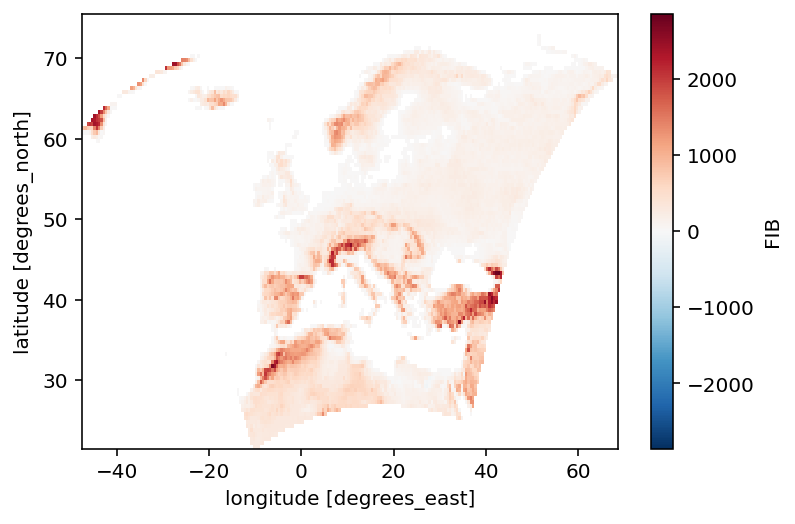

In [33]:
remo_topo_regrid.where(mask > 0, drop=True).plot()

In [34]:
correction = height_correction(remo_topo_regrid, cru_topo).where(mask > 0, drop=True)

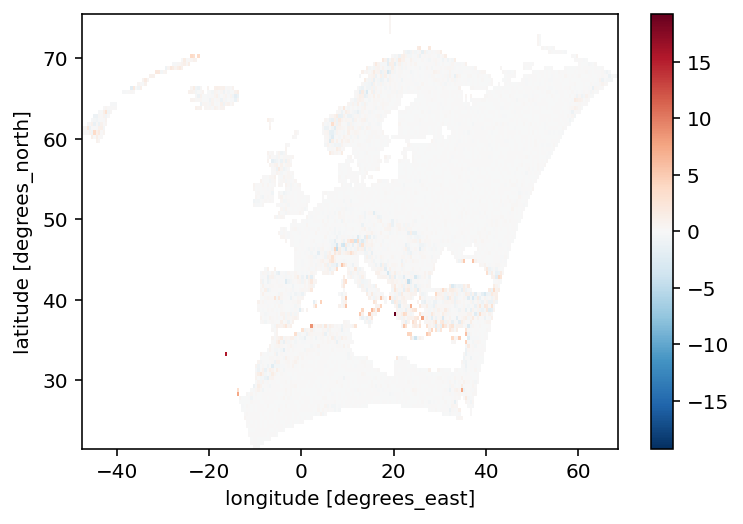

In [35]:
correction.plot()

/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/xesmf/frontend.py:466: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  dr_out = xr.apply_ufunc(


<module 'matplotlib.pyplot' from '/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/matplotlib/pyplot.py'>

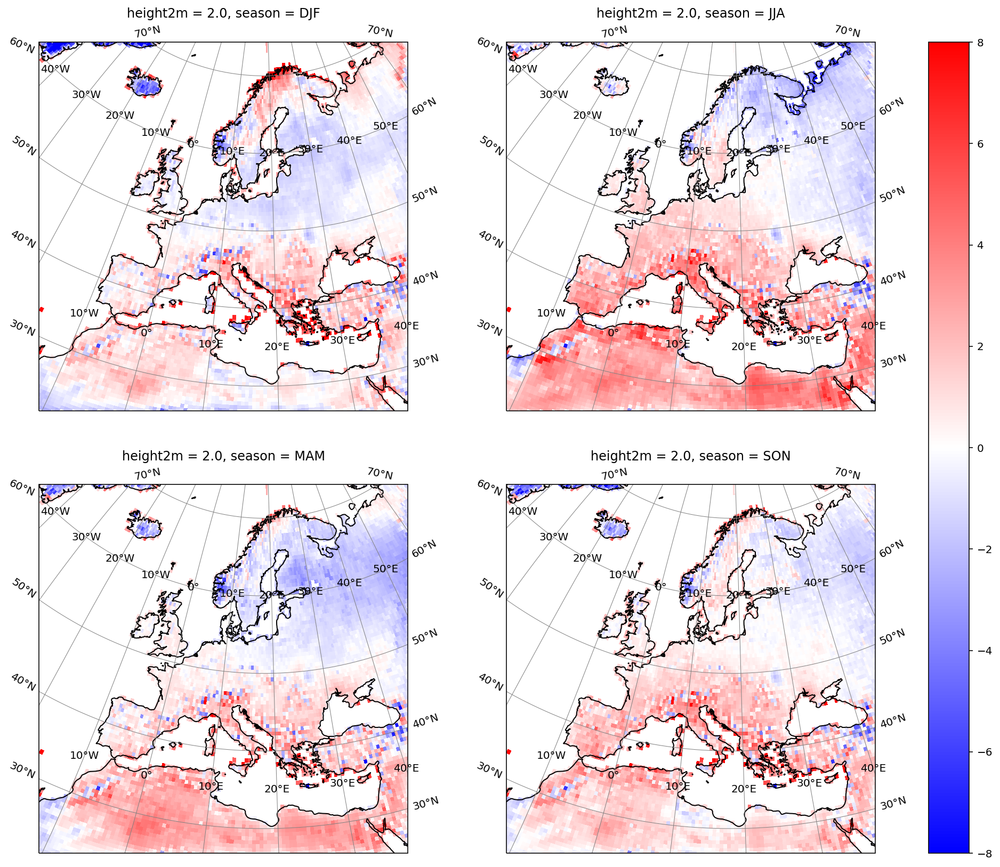

In [36]:
cru_seasmean = (
    cru_tmp.tmp.sel(time=slice(startyear, stopyear)).groupby("time.season").mean("time")
)
remo_seasmean = ds.TEMP2.groupby("time.season").mean("time") - 273.5
remo_seasmean = regridder(remo_seasmean) + correction
remo_seasmean = remo_seasmean.where(remo_seasmean != 0.0)
diff2 = remo_seasmean - cru_seasmean
plot_seasons(diff2.where(mask > 0, drop=True), pole, vmin=-8, vmax=8)

Now, let's look at the bias difference that we get from the height correction

<module 'matplotlib.pyplot' from '/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/matplotlib/pyplot.py'>

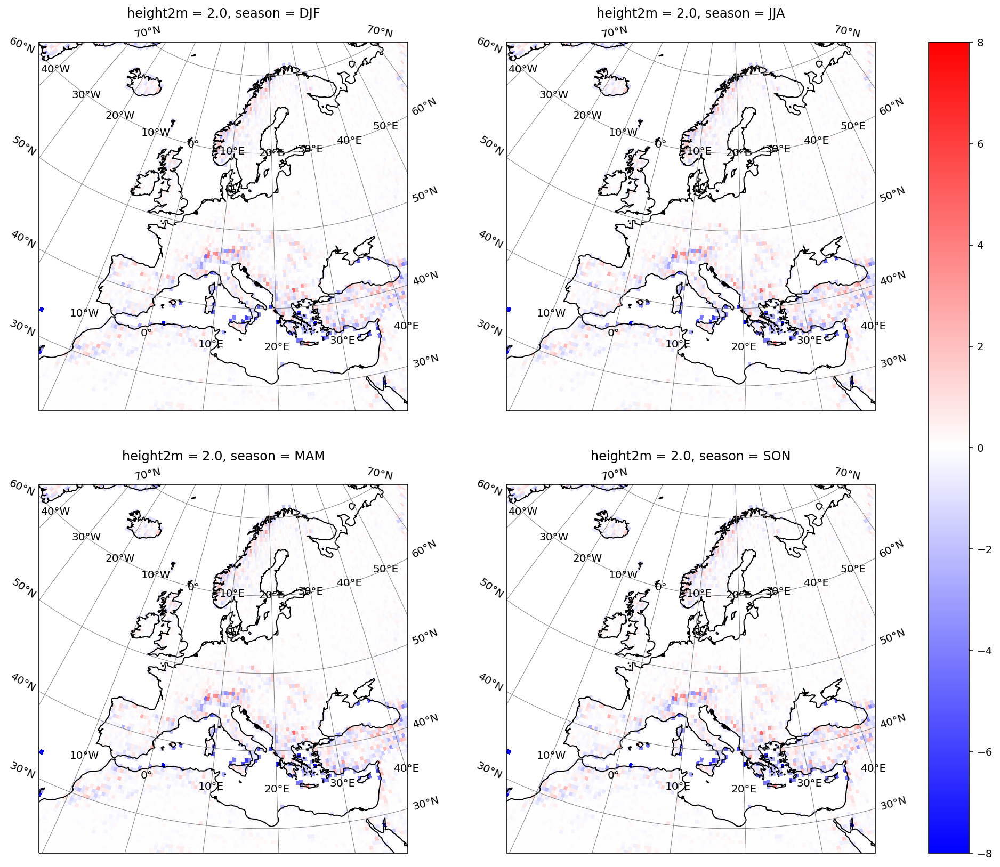

In [37]:
plot_seasons((diff1 - diff2).where(mask > 0, drop=True), pole, vmin=-8, vmax=8)

How can we get rid of those coastline artifacts? Should we mask REMO data by its own land sea mask before regridding? REMO topography has no sea topography but CRU has. That's why we get those artifacts at the coastline i guess.

#### Annual temperature cycle

Now, plot the annual temperature cycle 

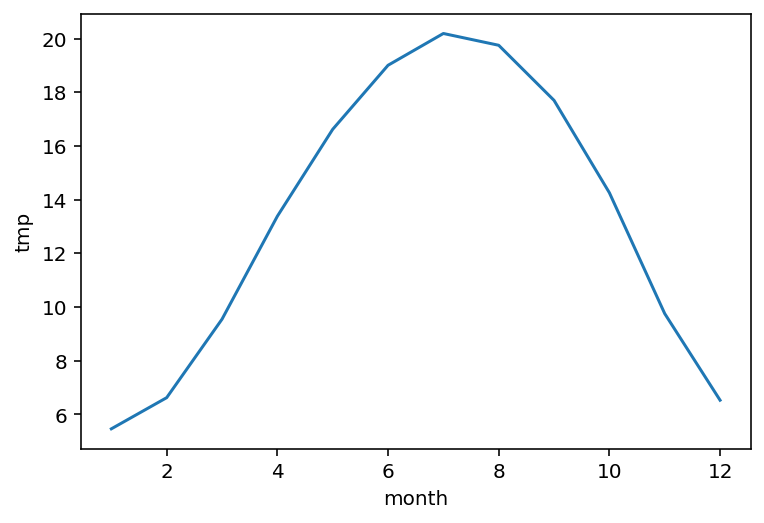

In [124]:
weight = np.cos(np.deg2rad(cru_tmp.lat))
temp_cycle_cru = (
    cru_tmp.tmp.groupby("time.month")
    .mean("time")
    .weighted(weight)
    .mean(dim=("lat", "lon"))
)
temp_cycle_cru.plot()

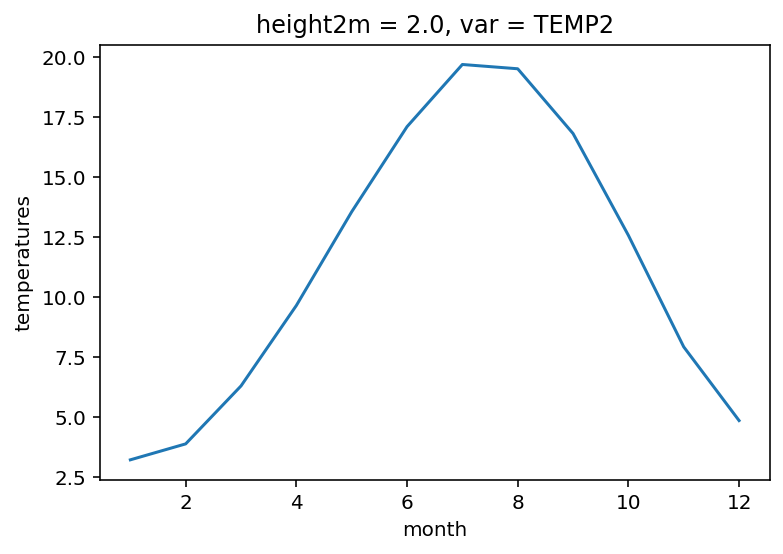

In [125]:
temps_cycle.sel(var="TEMP2").plot()

And compare it to the annual REMO cycle.

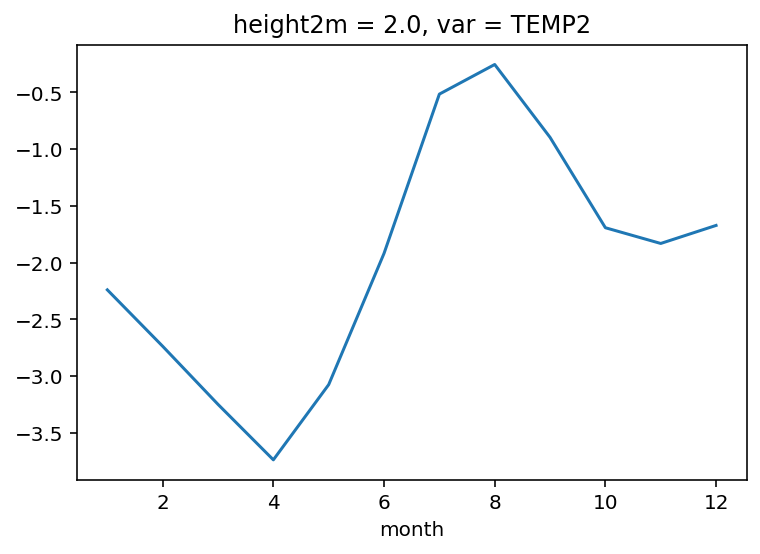

In [121]:
(temps_cycle.sel(var="TEMP2") - temp_cycle_cru).plot()

### E-OBS

In [38]:
eobs_ts = "/mnt/lustre02/work/ch0636/eddy/pool/obs/eobs/v22.0e/original_025/day/var/tas/tg_ens_mean_0.25deg_reg_v22.0e.nc"
# eobs_tmp = xr.open_dataset(eobs_ts.format(var='tg'), chunks='auto', use_cftime=True)
eobs_tmp = open_mfdataset(eobs_ts, parallel=True, chunks="auto")

In [51]:
eobs_tmp

<xarray.Dataset>
Dimensions:    (latitude: 201, longitude: 464, time: 25749)
Coordinates:
  * longitude  (longitude) float64 -40.38 -40.12 -39.88 ... 74.88 75.12 75.38
  * latitude   (latitude) float64 25.38 25.62 25.88 26.12 ... 74.88 75.12 75.38
  * time       (time) object 1950-01-01 00:00:00 ... 2020-06-30 00:00:00
Data variables:
    tg         (time, latitude, longitude) float32 dask.array<chunksize=(8583, 65, 116), meta=np.ndarray>
Attributes:
    E-OBS_version:  22.0e
    Conventions:    CF-1.4
    References:     http://surfobs.climate.copernicus.eu/dataaccess/access_eo...
    history:        Tue Dec  1 07:45:09 2020: ncks --no-abc -d time,0,25748 /...
    NCO:            netCDF Operators version 4.7.5 (Homepage = http://nco.sf....

In [52]:
import xesmf as xe

In [39]:
%time regridder = xe.Regridder(ds, eobs_tmp, "bilinear")
regridder

CPU times: user 3.38 s, sys: 114 ms, total: 3.5 s
Wall time: 3.25 s


xESMF Regridder 
Regridding algorithm:       bilinear 
Weight filename:            bilinear_433x433_201x464.nc 
Reuse pre-computed weights? False 
Input grid shape:           (433, 433) 
Output grid shape:          (201, 464) 
Periodic in longitude?      False

/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/xesmf/frontend.py:466: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  dr_out = xr.apply_ufunc(


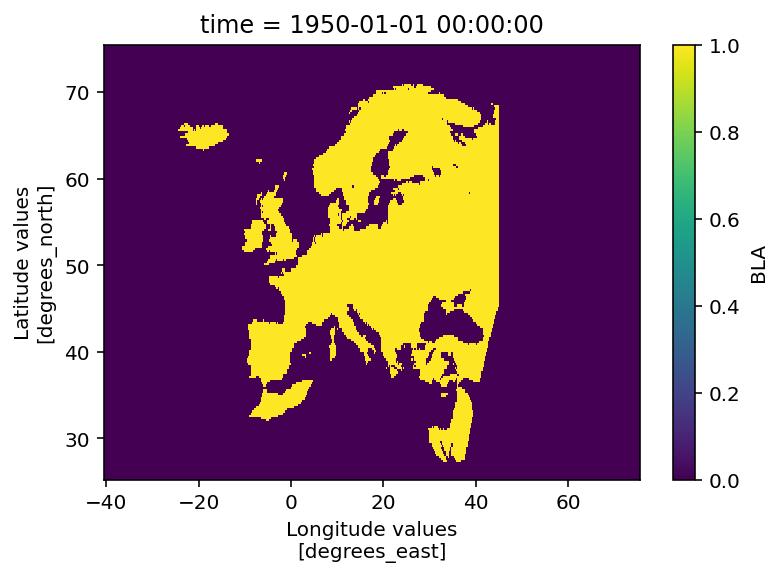

In [40]:
mask = xr.where(eobs_tmp.tg[0].isnull(), False, True)
mask = xr.where(regridder(remo_lsm).where(mask) > 0, True, False).squeeze(drop=True)
mask.plot()

In [41]:
eobs_seasmean = (
    eobs_tmp.tg.sel(time=slice(startyear, stopyear)).groupby("time.season").mean("time")
)
remo_seasmean = ds.TEMP2.groupby("time.season").mean("time") - 273.5
remo_seasmean = regridder(remo_seasmean)
remo_seasmean = remo_seasmean.where(remo_seasmean != 0.0)
diff1 = remo_seasmean - eobs_seasmean

/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/xesmf/frontend.py:466: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  dr_out = xr.apply_ufunc(


In [56]:
def plot_seasons(da, pole, vmin=None, vmax=None, cmap="bwr"):
    """plot seasonal means"""
    import cartopy.crs as ccrs
    from matplotlib import pyplot as plt

    transform = ccrs.RotatedPole(pole[0], pole[1])
    projection = transform
    # plt.subplots_adjust(hspace=1.5, wspace=1.0)
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(
        ncols=2, nrows=2, subplot_kw={"projection": projection}, figsize=(18, 14)
    )

    axes = (ax1, ax2, ax3, ax4)
    for ax in axes:
        # ax.set_axis_off()
        ax.set_extent(
            [ds.rlon.min(), ds.rlon.max(), ds.rlat.min(), ds.rlat.max()], crs=transform
        )
        ax.gridlines(
            draw_labels=True,
            linewidth=0.5,
            color="gray",
            xlocs=range(-180, 180, 10),
            ylocs=range(-90, 90, 10),
        )
        ax.coastlines(resolution="50m", color="black", linewidth=1)
    for season, ax in zip(da.season, axes):
        im = da.sel(season=season).plot(
            ax=ax,
            vmin=vmin,
            vmax=vmax,
            cmap=cmap,
            transform=ccrs.PlateCarree(),
            add_colorbar=False,
        )
    cbar = fig.colorbar(im, ax=axes)
    return plt

<module 'matplotlib.pyplot' from '/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/matplotlib/pyplot.py'>

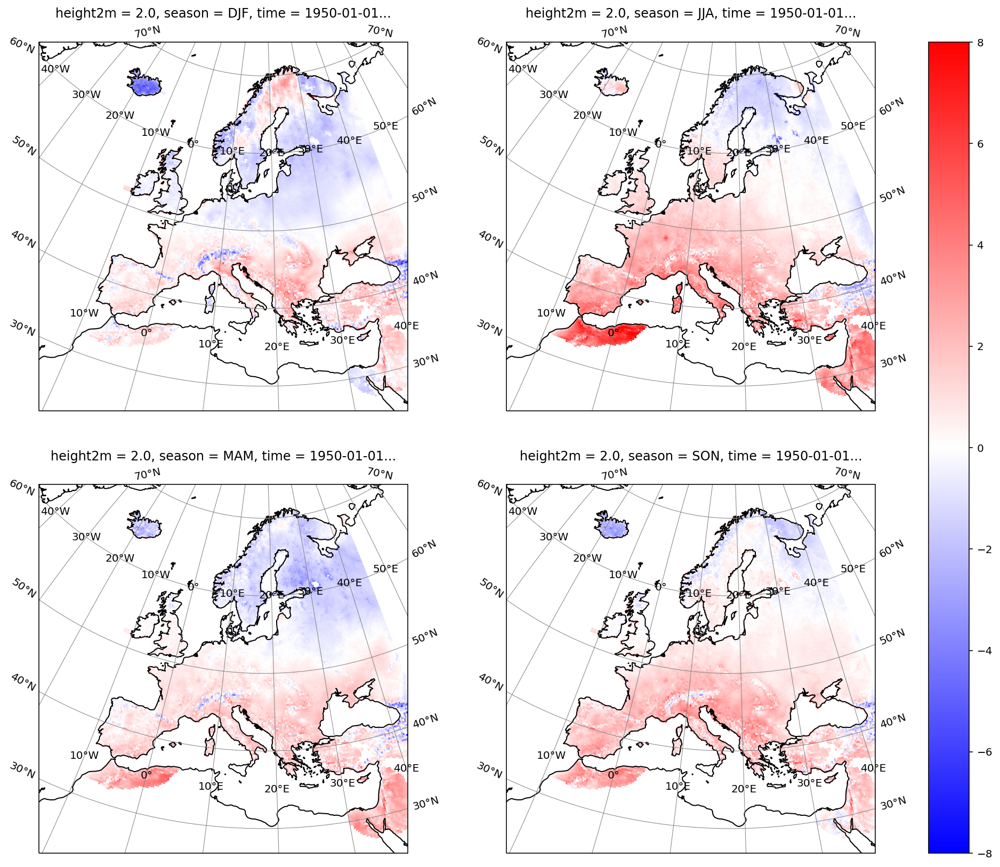

In [42]:
plot_seasons(diff1.where(mask > 0, drop=True), pole, vmin=-8, vmax=8)

#### Height correction

In [58]:
def height_correction(height1, height2):
    """returns height correction in m"""
    return (height1 - height2) * 0.0065

In [43]:
eobs_topo = xr.open_dataset(
    "/mnt/lustre02/work/ch0636/eddy/pool/obs/eobs/v22.0e/original_025/fx/orog/elev_ens_0.25deg_reg_v22.0e.nc"
).elevation
eobs_topo

<xarray.DataArray 'elevation' (latitude: 201, longitude: 464)>
array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]], dtype=float32)
Coordinates:
  * longitude  (longitude) float64 -40.38 -40.12 -39.88 ... 74.88 75.12 75.38
  * latitude   (latitude) float64 25.38 25.62 25.88 26.12 ... 74.88 75.12 75.38
Attributes:
    units:      metres
    long_name:  Elevation

In [44]:
remo_topo_regrid = regridder(remo_topo)

/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/xesmf/frontend.py:466: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  dr_out = xr.apply_ufunc(


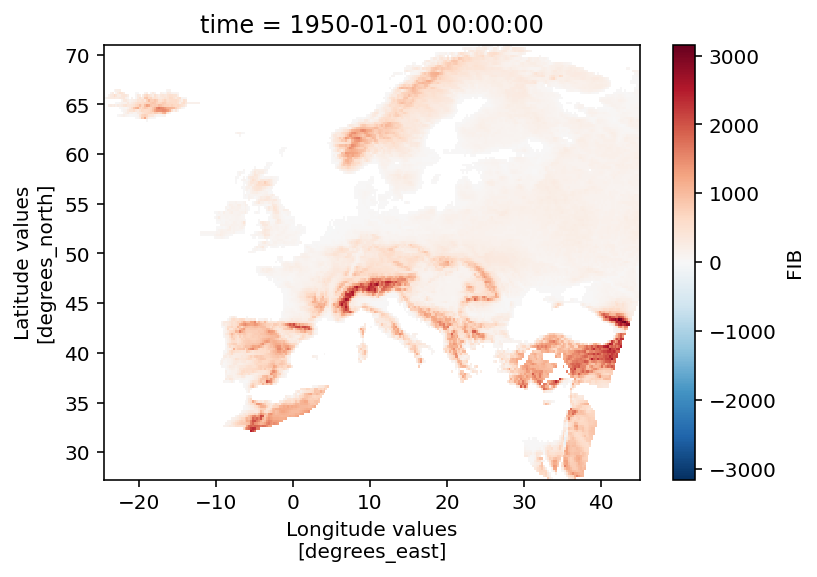

In [45]:
remo_topo_regrid.where(mask > 0, drop=True).plot()

In [46]:
correction = height_correction(remo_topo_regrid, eobs_topo)

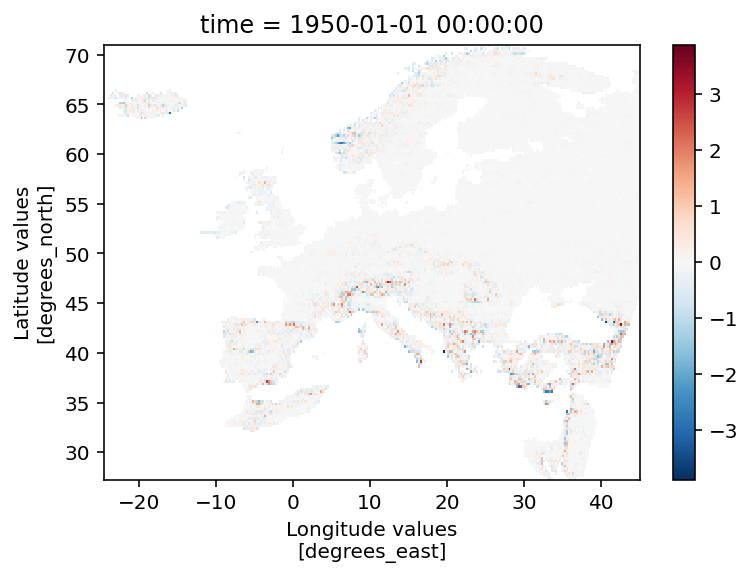

In [47]:
correction.where(mask > 0, drop=True).plot()

/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/xesmf/frontend.py:466: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  dr_out = xr.apply_ufunc(


<module 'matplotlib.pyplot' from '/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/matplotlib/pyplot.py'>

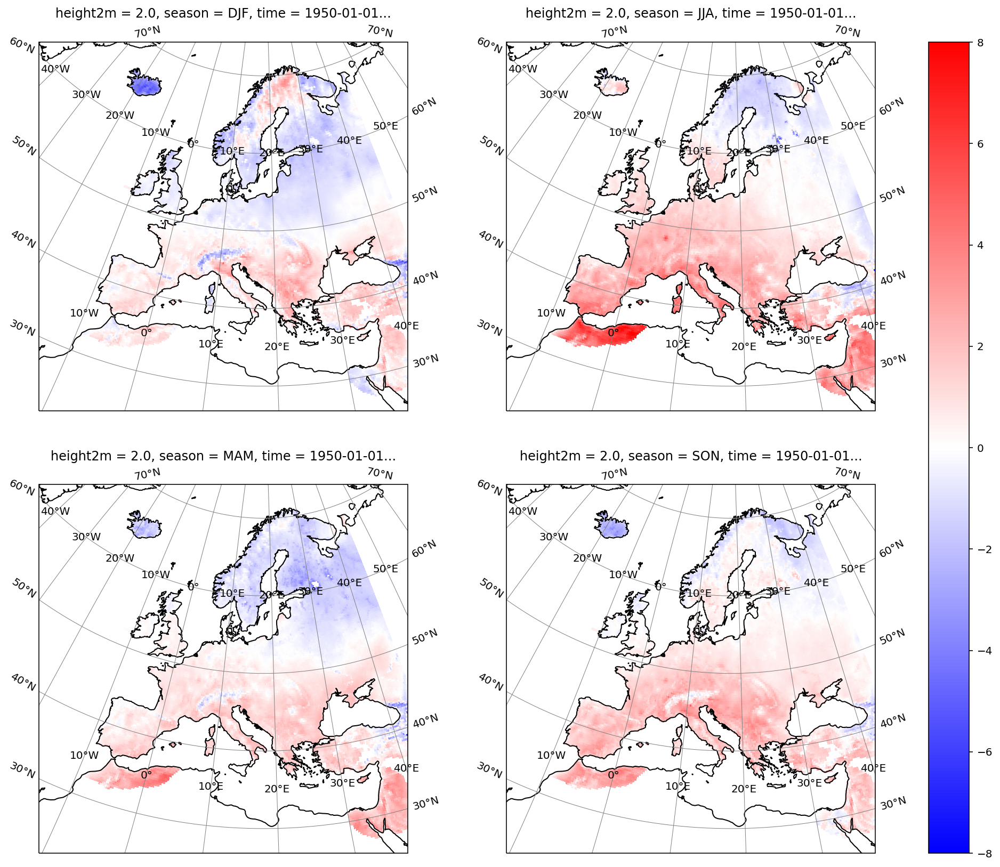

In [48]:
eobs_seasmean = (
    eobs_tmp.tg.sel(time=slice(startyear, stopyear)).groupby("time.season").mean("time")
)
remo_seasmean = ds.TEMP2.groupby("time.season").mean("time") - 273.5
remo_seasmean = regridder(remo_seasmean) + correction
remo_seasmean = remo_seasmean.where(remo_seasmean != 0.0)
diff2 = remo_seasmean - eobs_seasmean
plot_seasons(diff2.where(mask > 0, drop=True), pole, vmin=-8, vmax=8)

<module 'matplotlib.pyplot' from '/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/matplotlib/pyplot.py'>

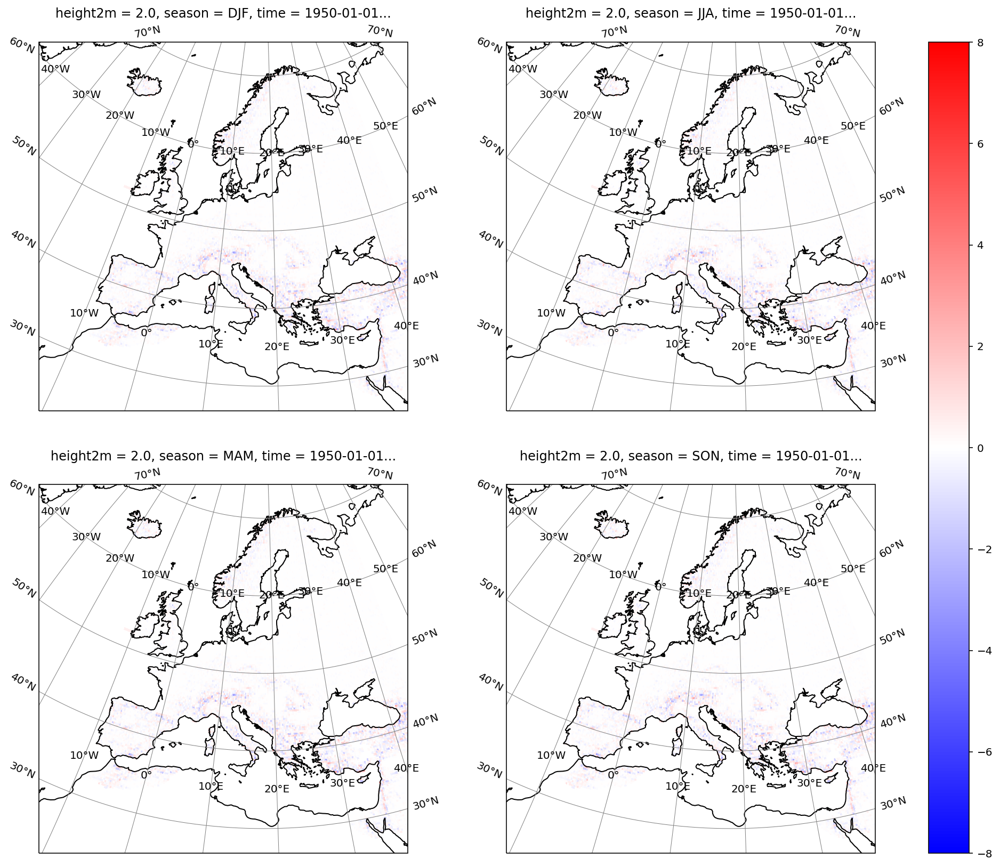

In [49]:
plot_seasons((diff1 - diff2).where(mask > 0, drop=True), pole, vmin=-8, vmax=8)

### Annual temperature cycle

Now, plot the annual temperature cycle 

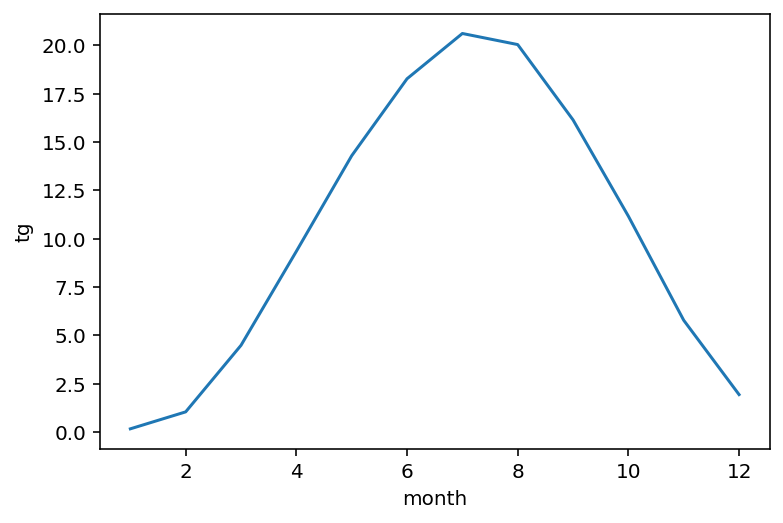

In [135]:
weight = np.cos(np.deg2rad(eobs_tmp.latitude))
temp_cycle_eobs = (
    eobs_tmp.tg.groupby("time.month")
    .mean("time")
    .weighted(weight)
    .mean(dim=("latitude", "longitude"))
)
temp_cycle_eobs.plot()

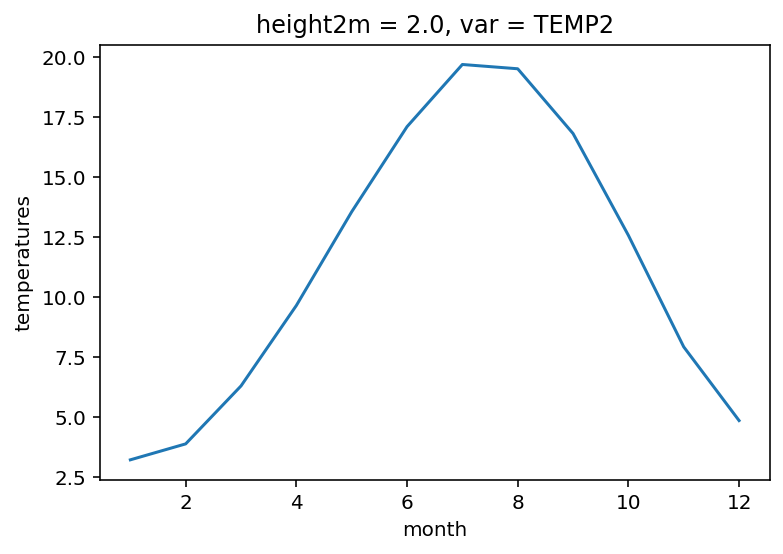

In [128]:
temps_cycle.sel(var="TEMP2").plot()

And compare it to the annual REMO cycle.

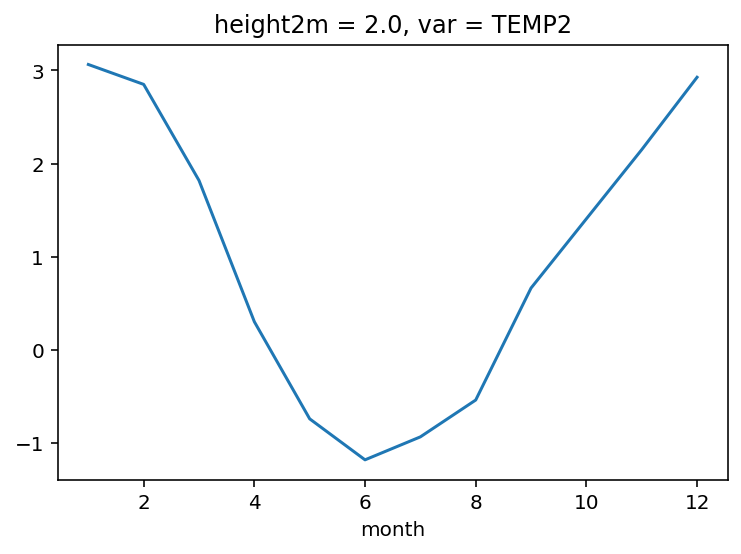

In [129]:
(temps_cycle.sel(var="TEMP2") - temp_cycle_eobs).plot()

Where comes the strange 'annual cycle' from?

## Comparision with reanalysis data 

Now, we can do the same comparision with reanalysis data

### ERA5

We have to convert the ERA5 longitude from '0 - 360' to '-180 - 180'

In [50]:
def assign_coords(dataset):
    return dataset.assign_coords(lon=(((dataset.lon + 180) % 360) - 180)).sortby("lon")

In [51]:
import parse

pattern = "/mnt/lustre02/work/ch0636/eddy/pool/reana/era5/daily/tas/*.nc"
files = []
for file in glob.glob(pattern):
    year = parse.parse("{}_{}_{}_{}", file)[3].split(".")[0]
    if "-" in year:
        continue
    try:
        if int(year[:4]) <= int(stopyear) and int(year[:4]) >= int(startyear):
            files.append(file)
    except:
        pass
era_tmp = open_mfdataset(sorted(files), parallel=True, chunks="auto")
era_tmp = assign_coords(era_tmp)

/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/xarray/core/indexing.py:1379: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  return self.array[key]


In [89]:
era_tmp

<xarray.Dataset>
Dimensions:    (bnds: 2, lat: 721, lon: 1440, time: 4018)
Coordinates:
  * time       (time) datetime64[ns] 1979-01-01 1979-01-01 ... 1989-12-01
  * lon        (lon) float64 -180.0 -179.8 -179.5 -179.2 ... 179.2 179.5 179.8
  * lat        (lat) float64 90.0 89.75 89.5 89.25 ... -89.25 -89.5 -89.75 -90.0
Dimensions without coordinates: bnds
Data variables:
    time_bnds  (time, bnds) float64 dask.array<chunksize=(31, 2), meta=np.ndarray>
    tas        (time, lat, lon) float64 dask.array<chunksize=(31, 721, 720), meta=np.ndarray>
Attributes:
    CDI:          Climate Data Interface version 1.9.8 (https://mpimet.mpg.de...
    Conventions:  CF-1.6
    history:      Thu Sep 10 13:08:06 2020: cdo -b F64 daymean tmp_tas.nc /mn...
    institution:  European Centre for Medium-Range Weather Forecasts
    frequency:    day
    CDO:          Climate Data Operators version 1.9.8 (https://mpimet.mpg.de...

In [52]:
from datetime import datetime as dt

time = list(era_tmp.time.astype(str).values)
era_tmp["time"] = [dt.strptime(t[0:6], "%Y%m") for t in time]

In [91]:
era_tmp.time

<xarray.DataArray 'time' (time: 4018)>
array(['1979-01-01T00:00:00.000000000', '1979-01-01T00:00:00.000000000',
       '1979-01-01T00:00:00.000000000', ..., '1989-12-01T00:00:00.000000000',
       '1989-12-01T00:00:00.000000000', '1989-12-01T00:00:00.000000000'],
      dtype='datetime64[ns]')
Coordinates:
  * time     (time) datetime64[ns] 1979-01-01 1979-01-01 ... 1989-12-01

distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Restarting worker


In [53]:
%time regridder = xe.Regridder(ds, era_tmp, "bilinear")
regridder

CPU times: user 5.13 s, sys: 141 ms, total: 5.27 s
Wall time: 4.88 s


xESMF Regridder 
Regridding algorithm:       bilinear 
Weight filename:            bilinear_433x433_721x1440.nc 
Reuse pre-computed weights? False 
Input grid shape:           (433, 433) 
Output grid shape:          (721, 1440) 
Periodic in longitude?      False

We want a mask that only shows our EUR-11 region on the ERA5 grid.

/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/xesmf/frontend.py:466: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  dr_out = xr.apply_ufunc(


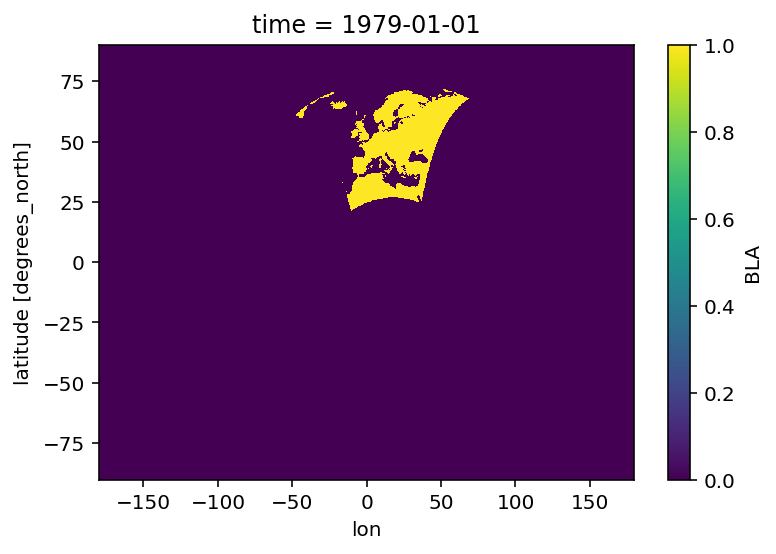

In [65]:
mask = xr.where(era_tmp.tas[0].isnull(), False, True)
# mask = xr.where(remo_ts_regrid[0].where(mask) > 0, True, False).squeeze(drop=True) # remove height2m
mask = xr.where(regridder(remo_lsm).where(mask) > 0, True, False).squeeze(
    drop=True
)  # remove height2m
mask.plot()

Compute seasonal means and difference between REMO and ERA5.

In [54]:
era_seasmean = (
    era_tmp.tas.sel(time=slice(startyear, stopyear)).groupby("time.season").mean("time")
    - 273.15
)
remo_seasmean = ds.TEMP2.groupby("time.season").mean("time") - 273.5
remo_seasmean = regridder(remo_seasmean)
remo_seasmean = remo_seasmean.where(remo_seasmean != 0.0)
diff1 = remo_seasmean - era_seasmean

/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/xesmf/frontend.py:466: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  dr_out = xr.apply_ufunc(


We need to define a new plotting function because we now plot on the ERA5 grid.

In [84]:
def plot_seasons(da, pole, vmin=None, vmax=None, cmap="bwr"):
    """plot seasonal means"""
    import cartopy.crs as ccrs
    from matplotlib import pyplot as plt

    transform = ccrs.RotatedPole(pole[0], pole[1])
    projection = transform
    # plt.subplots_adjust(hspace=1.5, wspace=1.0)
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(
        ncols=2, nrows=2, subplot_kw={"projection": projection}, figsize=(18, 14)
    )

    axes = (ax1, ax2, ax3, ax4)
    for ax in axes:
        # ax.set_axis_off()
        ax.set_extent(
            [ds.rlon.min(), ds.rlon.max(), ds.rlat.min(), ds.rlat.max()], crs=transform
        )
        ax.gridlines(
            draw_labels=True,
            linewidth=0.5,
            color="gray",
            xlocs=range(-180, 180, 10),
            ylocs=range(-90, 90, 10),
        )
        ax.coastlines(resolution="50m", color="black", linewidth=1)
    for season, ax in zip(da.season, axes):
        im = da.sel(season=season).plot(
            ax=ax,
            vmin=vmin,
            vmax=vmax,
            cmap=cmap,
            transform=ccrs.PlateCarree(),
            add_colorbar=False,
        )
    cbar = fig.colorbar(im, ax=axes)
    return plt

<module 'matplotlib.pyplot' from '/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/matplotlib/pyplot.py'>

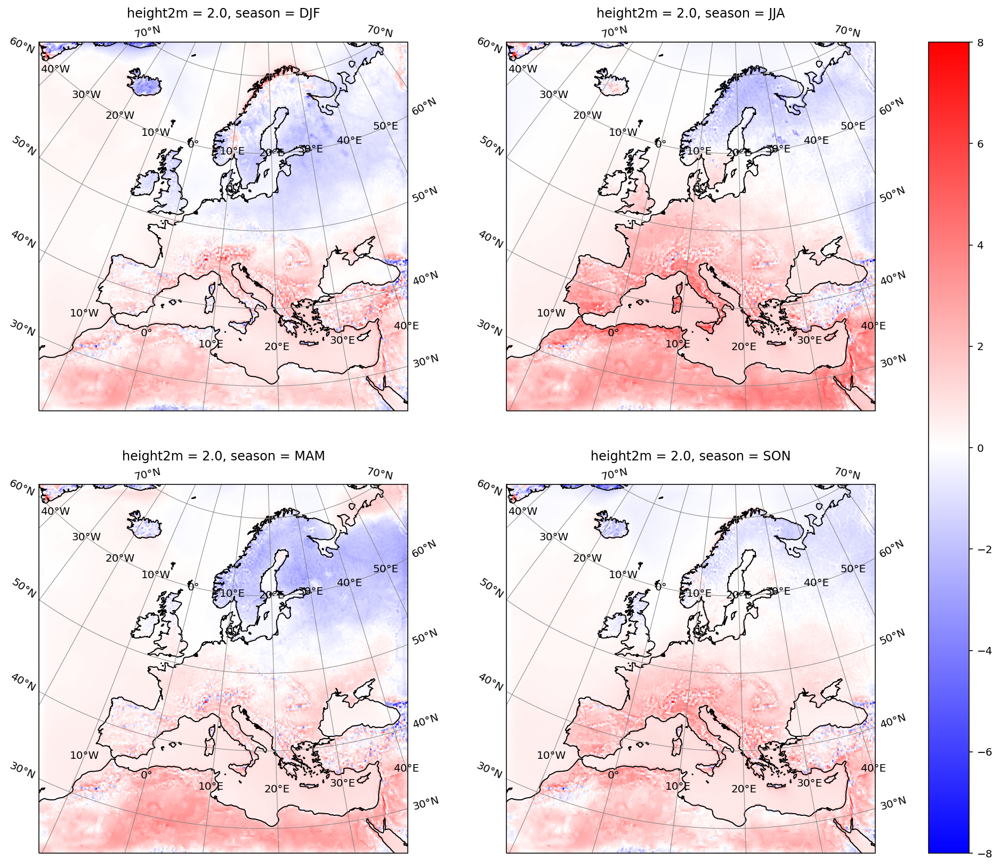

In [55]:
plot_seasons(diff1, pole, vmin=-8, vmax=8)

#### Height correction

We will add a height correction based on the different topographies. Let's define a function for this:

This ERA5 topography file is available on mistral:

In [56]:
era_topo = xr.open_dataset(
    "/mnt/lustre02/work/ch0636/eddy/pool/reana/era5/orography.nc"
).squeeze(
    drop=True
)  # remove time
era_topo

<xarray.Dataset>
Dimensions:  (lat: 721, lon: 1440)
Coordinates:
  * lon      (lon) float64 0.0 0.25 0.5 0.75 1.0 ... 359.0 359.2 359.5 359.8
  * lat      (lat) float64 90.0 89.75 89.5 89.25 ... -89.25 -89.5 -89.75 -90.0
Data variables:
    z        (lat, lon) float64 ...
Attributes:
    CDI:          Climate Data Interface version 1.9.7.1 (http://mpimet.mpg.d...
    Conventions:  CF-1.6
    history:      Wed May 13 11:00:13 2020: cdo chunit,m**2/s**2,m -divc,9.80...
    institution:  European Centre for Medium-Range Weather Forecasts
    CDO:          Climate Data Operators version 1.9.7.1 (http://mpimet.mpg.d...

Now, convert the longitude range from 0-360 to -180-180  
See 

In [57]:
era_topo = assign_coords(era_topo).z
era_topo

<xarray.DataArray 'z' (lat: 721, lon: 1440)>
[1038240 values with dtype=float64]
Coordinates:
  * lon      (lon) float64 -180.0 -179.8 -179.5 -179.2 ... 179.2 179.5 179.8
  * lat      (lat) float64 90.0 89.75 89.5 89.25 ... -89.25 -89.5 -89.75 -90.0
Attributes:
    long_name:  geopotential
    units:      m
    code:       129
    table:      128

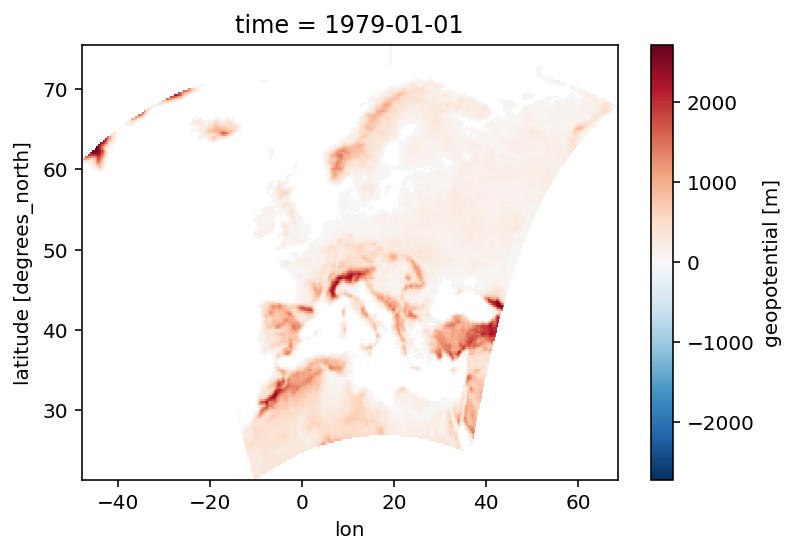

In [66]:
era_topo.where(mask > 0, drop=True).plot()

We take the remo topography file from above. See comparision with CRU.

In [60]:
remo_topo_regrid = regridder(remo_topo)

/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/xesmf/frontend.py:466: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  dr_out = xr.apply_ufunc(


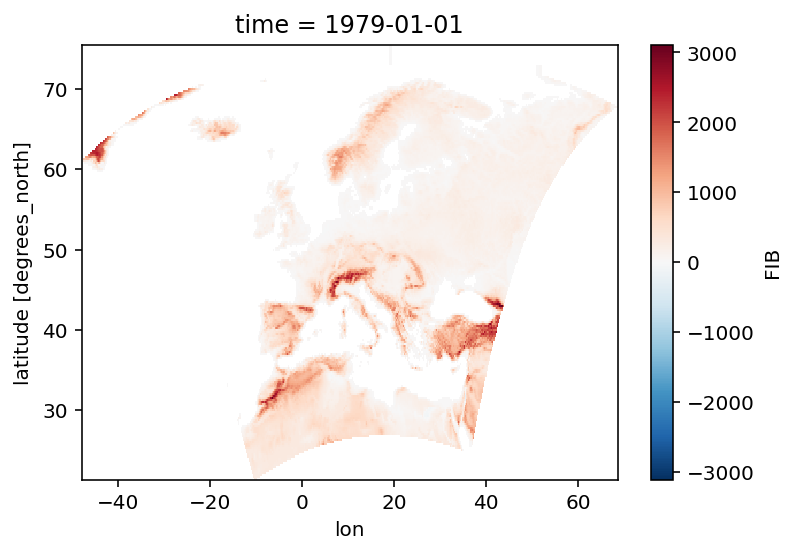

In [67]:
remo_topo_regrid.where(mask > 0, drop=True).plot()

Now, do the height correction.

In [62]:
correction = height_correction(remo_topo_regrid, era_topo)

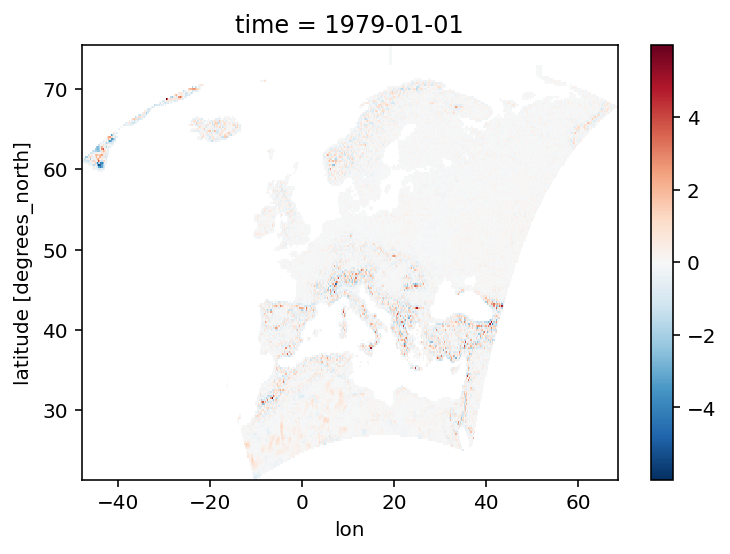

In [68]:
correction.where(mask > 0, drop=True).plot()

This looks a lot better than the CRU correction.

/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/xesmf/frontend.py:466: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  dr_out = xr.apply_ufunc(


<module 'matplotlib.pyplot' from '/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/matplotlib/pyplot.py'>

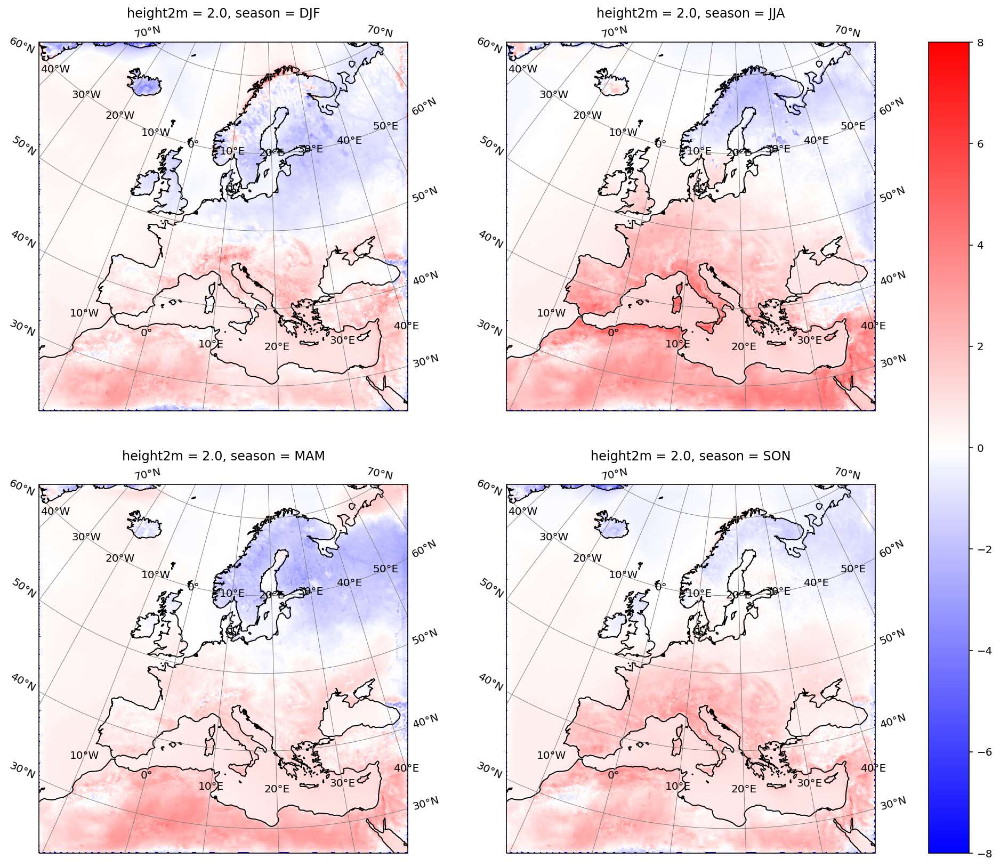

In [71]:
era_seasmean = (
    era_tmp.tas.sel(time=slice(startyear, stopyear)).groupby("time.season").mean("time")
    - 273.15
)
remo_seasmean = ds.TEMP2.groupby("time.season").mean("time") - 273.5
remo_seasmean = regridder(remo_seasmean) + correction
remo_seasmean = remo_seasmean.where(remo_seasmean != 0.0)
diff2 = remo_seasmean - era_seasmean
plot_seasons(diff2, pole, vmin=-8, vmax=8)

Now, let's look at the bias difference that we get from the height correction

<module 'matplotlib.pyplot' from '/pf/g/g300100/kernels/mypython3/lib/python3.9/site-packages/matplotlib/pyplot.py'>

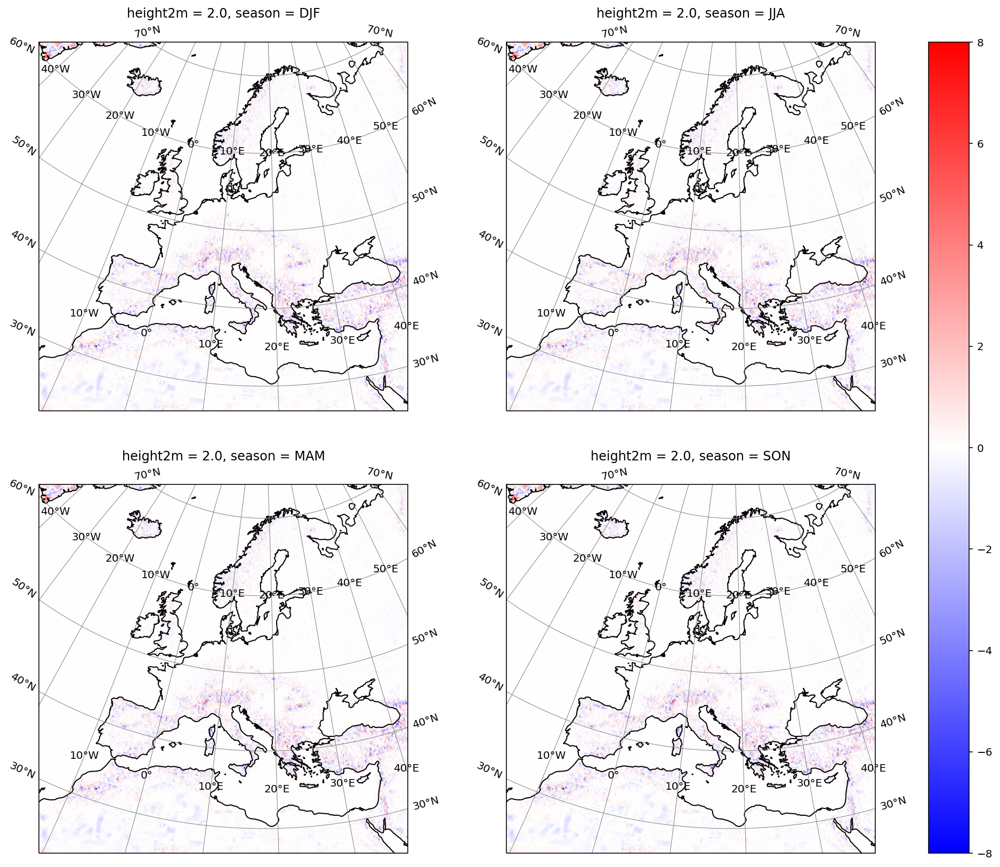

In [131]:
plot_seasons((diff1 - diff2), pole, vmin=-8, vmax=8)

### Annual temperature cycle

Now, plot the annual temperature cycle 

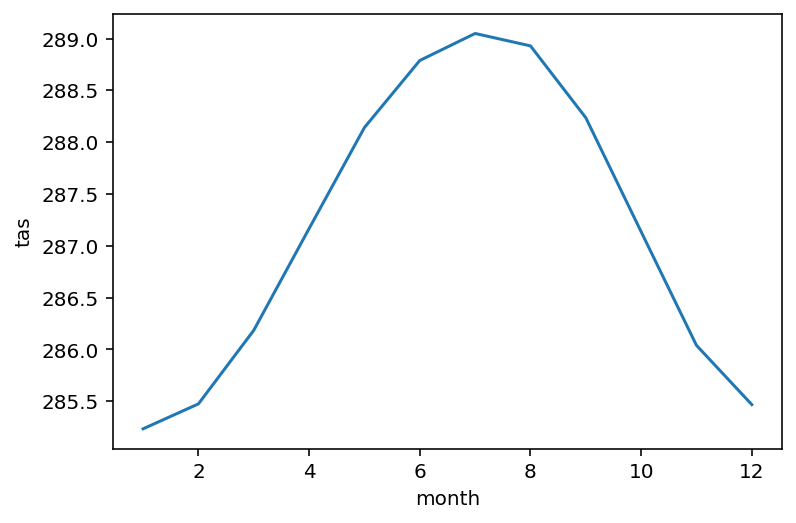

In [132]:
weight = np.cos(np.deg2rad(era_tmp.lat))
temp_cycle_era = (
    era_tmp.tas.groupby("time.month")
    .mean("time")
    .weighted(weight)
    .mean(dim=("lat", "lon"))
)
temp_cycle_era.plot()

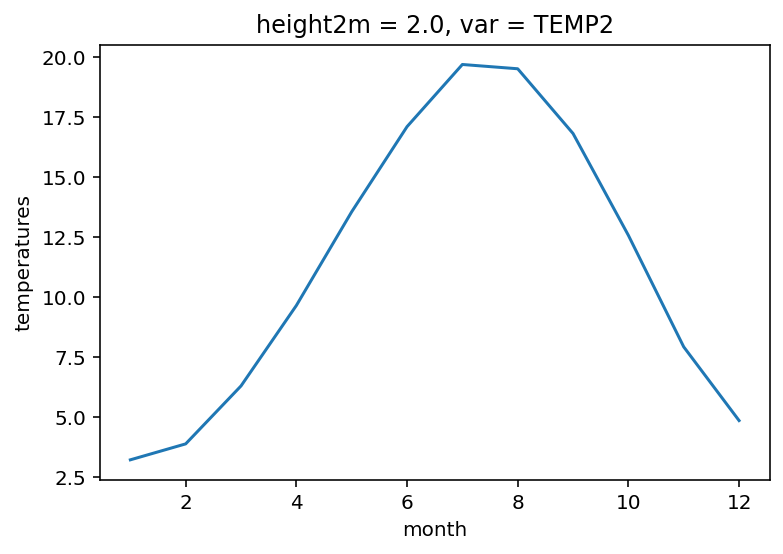

In [125]:
temps_cycle.sel(var="TEMP2").plot()

And compare it to the annual REMO cycle.

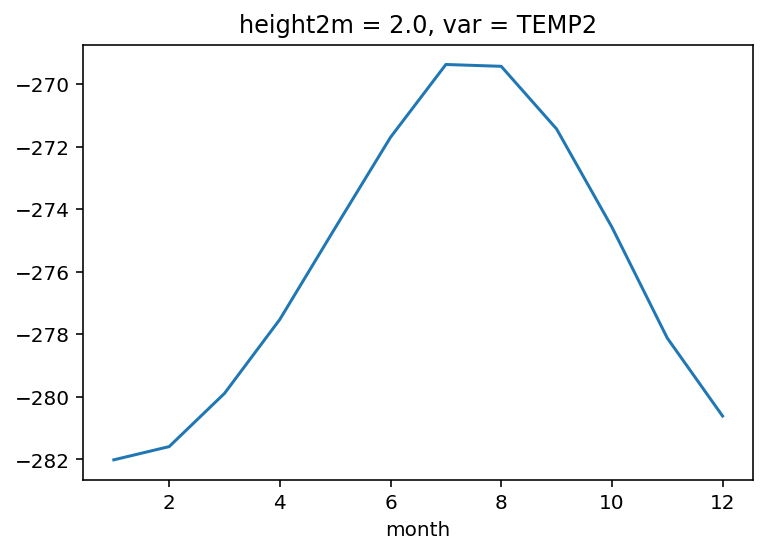

In [133]:
(temps_cycle.sel(var="TEMP2") - temp_cycle_era).plot()

Where comes the strange 'annual cycle' from?